In [2]:
import matplotlib.pyplot as plt
import numpy as np
import os, scipy
import matplotlib.colors as mcolors
import networkx as nx
import pickle

# We import the model, stimuli, and the optimal control package
from neurolib.models.wc import WCModel
from neurolib.utils.stimulus import ZeroInput
from neurolib.control.optimal_control import oc_wc, cost_functions

import matplotlib as mpl
label_size= 20
mpl.rcParams['xtick.labelsize'] = label_size
mpl.rcParams['ytick.labelsize'] = label_size
mpl.rcParams['font.size'] = label_size
mpl.rcParams['axes.titlesize'] = label_size
mpl.rcParams['axes.titlesize'] = label_size
mpl.rcParams['figure.titlesize'] = label_size
mpl.rcParams['lines.linewidth'] = 1

# This will reload all imports as soon as the code changes
%load_ext autoreload
%autoreload 2

while "Promotion/neurolib" in os.getcwd():
    os.chdir('..')

pickledir = os.path.join(os.getcwd(), "neurolib_aln_osc_datastorage/optimal_control/WP2/2n")
dir = os.path.join(pickledir, "images_2n_wc")

print(dir)

cmap = plt.cm.get_cmap("jet")


def get_period(timeseries, dt):
    peaks = scipy.signal.find_peaks(timeseries)[0]
    periods = []
    for i in range(4, len(peaks)-1):
        periods.append( (peaks[i] - peaks[i-1]) * dt)
    return np.mean(periods)

def get_peak_time_delay(ts0, ts1, dt):
    peaks0 = scipy.signal.find_peaks(ts0)[0][4:]
    peaks1 = scipy.signal.find_peaks(ts1)[0][4:]

    mindiff = 100000
    for p in peaks0:
        for p1 in peaks1:
            if np.abs(p1-p) < np.abs(mindiff):
                mindiff = p1-p

    return mindiff * dt   

def get_norm_period(timeseries, lim=1e-3):
    if np.amax(np.abs(timeseries)) < lim:
        return None

    prom = 1e-4
    peaks = scipy.signal.find_peaks(timeseries, prominence=prom)[0]
    
    if len(peaks) < 2:
        plt.plot(timeseries)
        plt.show()
            
    while (peaks[2] - peaks[1]) < 180:
        prom *= 2
        peaks = scipy.signal.find_peaks(timeseries, prominence=prom)[0]
    
    ts = timeseries[peaks[1]:]
    r0, r1 = 0,0
    for t in range(len(ts)):
        if ts[t] >= 0 and ts[t+1] < 0:
            r0 = t
            break
    ts = timeseries[peaks[2]:]
    for t in range(len(ts)):
        if ts[t] >= 0 and ts[t+1] < 0:
            r1 = t
            break

    ts = timeseries[peaks[1]+r0:peaks[2]+r1+1]
    if len(ts) < 180:
        plt.plot(timeseries)
        plt.show()
    return ts#/np.amax(np.abs(ts))

/home/lena/Promotion/neurolib_aln_osc_datastorage/optimal_control/WP2/2n/images_2n_wc


In [3]:
p_names = ["A", "B", "C", "D", "E", "F"]
coords = [[1., 1., "A"], [1.7, 2., "B"], [3., 1., "C"], [4., 2., "D"], [1., 0., "E"],[1.7, 0.6, "F"]]
coupling_array = np.arange(0.2, 2.3, 0.2)
delay_array = np.linspace(0, 18.9, 10)

N = 2
dt = 0.1

In [4]:
with open(os.path.join(pickledir, 'osc_2n_wc.pickle'), 'rb') as f:
    res_read = pickle.load(f)
    print(res_read.keys() )

data = res_read.copy()

dict_keys(['A', 'B', 'C', 'D', 'E', 'F'])


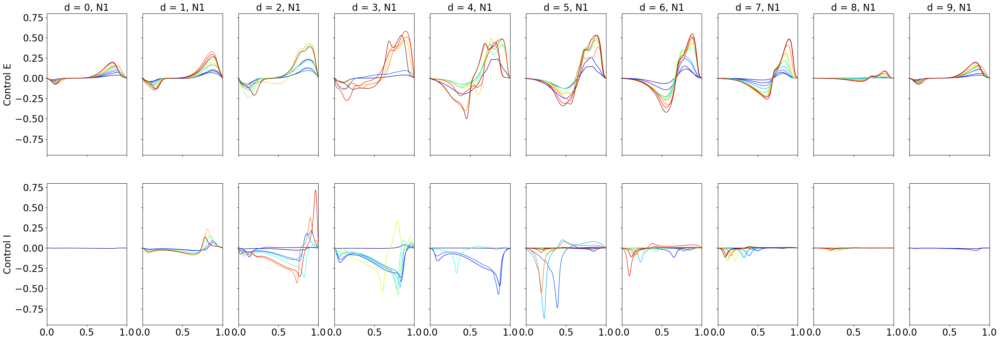

In [30]:
fig, ax = plt.subplots(2, len(delay_array), figsize=(36,12), sharex=True, sharey=True)

i = 0
p = "E"

a_lim = 1e-3

for di in range(len(delay_array)):

    #if di > 5: continue
    for ci in range(len(coupling_array)):

        col = cmap(ci/(len(coupling_array)-1))

        p1e = get_norm_period( data[p]["control"][i][di][ci][1,0,10000:11000], lim=a_lim)
        p1i = get_norm_period(data[p]["control"][i][di][ci][1,1,10000:11000], lim=a_lim)

        if p1e is not None:
            if len(p1e)*dt < data[p]["natural_period"][i][di][ci] -3:
                print("p1e too short", len(p1e), data[p]["natural_period"][i][di][ci], di, ci)
            timescale = np.linspace(0,1,len(p1e))
            ax[0,di].plot(timescale, p1e, color=col, linewidth=1)

        if p1i is not None:
            if len(p1i)*dt < data[p]["natural_period"][i][di][ci] -3:
                print("p1i too short", len(p1i), data[p]["natural_period"][i][di][ci], di, ci)
            timescale = np.linspace(0,1,len(p1i))
            ax[1,di].plot(timescale, p1i, color=col, linewidth=1)

    ax[0,di].set_title("d = {}, N1".format(di))    

ax[0,0].set_xlim(0,1)

ax[0,0].set_ylabel("Control E")
ax[1,0].set_ylabel("Control I")

plt.show()

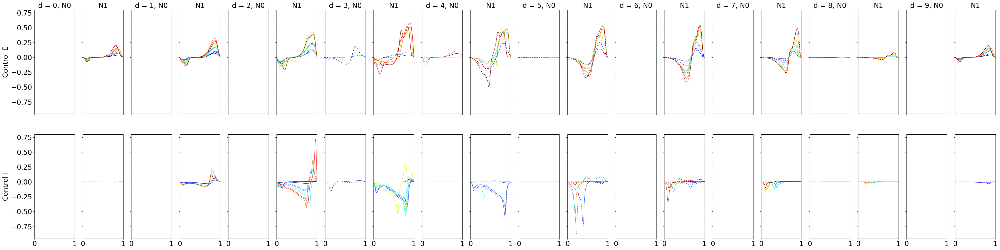

In [126]:
fig, ax = plt.subplots(2, 2*len(delay_array), figsize=(50,12), sharex=True, sharey=True)

i = 0
p = "E"

a_lim = 1e-3

for di in range(len(delay_array)):

    #if di > 5: continue
    for ci in range(len(coupling_array)):

        col = cmap(ci/(len(coupling_array)-1))

        p0e = get_norm_period(data[p]["control"][i][di][ci][0,0,10000:11000], lim=a_lim)
        p0i = get_norm_period(data[p]["control"][i][di][ci][0,1,10000:11000], lim=a_lim)
        p1e = get_norm_period(data[p]["control"][i][di][ci][1,0,10000:11000], lim=a_lim)
        p1i = get_norm_period(data[p]["control"][i][di][ci][1,1,10000:11000], lim=a_lim)

        if p0e is not None:
            if len(p0e)*dt < data[p]["natural_period"][i][di][ci] -3:
                print("p0e too short", len(p0e), data[p]["natural_period"][i][di][ci], di, ci)
            timescale = np.linspace(0,1,len(p0e))
            if data[p]["peak_time_delay"][i][di][ci] < 0:
                ax[0,2*di].plot(timescale, p0e, color=col, linewidth=1, linestyle="--")
            else:
                ax[0,2*di].plot(timescale, p0e, color=col, linewidth=1)

        if p0i is not None:
            if len(p0i)*dt < data[p]["natural_period"][i][di][ci] -3:
                print("p0i too short", len(p0i), data[p]["natural_period"][i][di][ci], di, ci)
            timescale = np.linspace(0,1,len(p0i))
            if data[p]["peak_time_delay"][i][di][ci] < 0:
                ax[1,2*di].plot(timescale, p0i, color=col, linewidth=1, linestyle="--")
            else:
                ax[1,2*di].plot(timescale, p0i, color=col, linewidth=1)

        if p1e is not None:
            if len(p1e)*dt < data[p]["natural_period"][i][di][ci] -3:
                print("p1e too short", len(p1e), data[p]["natural_period"][i][di][ci], di, ci)
            timescale = np.linspace(0,1,len(p1e))
            if data[p]["peak_time_delay"][i][di][ci] < 0:
                ax[0,2*di+1].plot(timescale, p1e, color=col, linewidth=1, linestyle="--")
            else:
                ax[0,2*di+1].plot(timescale, p1e, color=col, linewidth=1)

        if p1i is not None:
            if len(p1i)*dt < data[p]["natural_period"][i][di][ci] -3:
                print("p1i too short", len(p1i), data[p]["natural_period"][i][di][ci], di, ci)
            timescale = np.linspace(0,1,len(p1i))
            if data[p]["peak_time_delay"][i][di][ci] < 0:
                ax[1,2*di+1].plot(timescale, p1i, color=col, linewidth=1, linestyle="--")
            else:
                ax[1,2*di+1].plot(timescale, p1i, color=col, linewidth=1)

    ax[0,2*di].set_title("d = {}, N0".format(di))
    ax[0,2*di+1].set_title("N1".format(di))
    

ax[0,0].set_xlim(0,1)

ax[0,0].set_ylabel("Control E")
ax[1,0].set_ylabel("Control I")

plt.show()

cmat i =  0
---------------------- 0 0
target period, max delay =  18.89583333333334 0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.17702576887907842
Converged in iteration 2 with cost -0.1769668969219125
Final cost : -0.1769668969219125
Compute control for a deterministic system
Cost in iteration 0: -0.1769668969219125
Cost in iteration 20: -0.38308149669187647
Converged in iteration 26 with cost -0.4060165990015184
Final cost : -0.4060165990015184
Compute control for a deterministic system
Cost in iteration 0: -0.4060165990015184
Converged in iteration 7 with cost -0.4061111231598153
Final cost : -0.4061111231598153
Compute control for a deterministic system
Cost in iteration 0: -0.4061111231598153
Converged in iteration 1 with cost -0.4061111231598153
Final cost : -0.4061111231598153


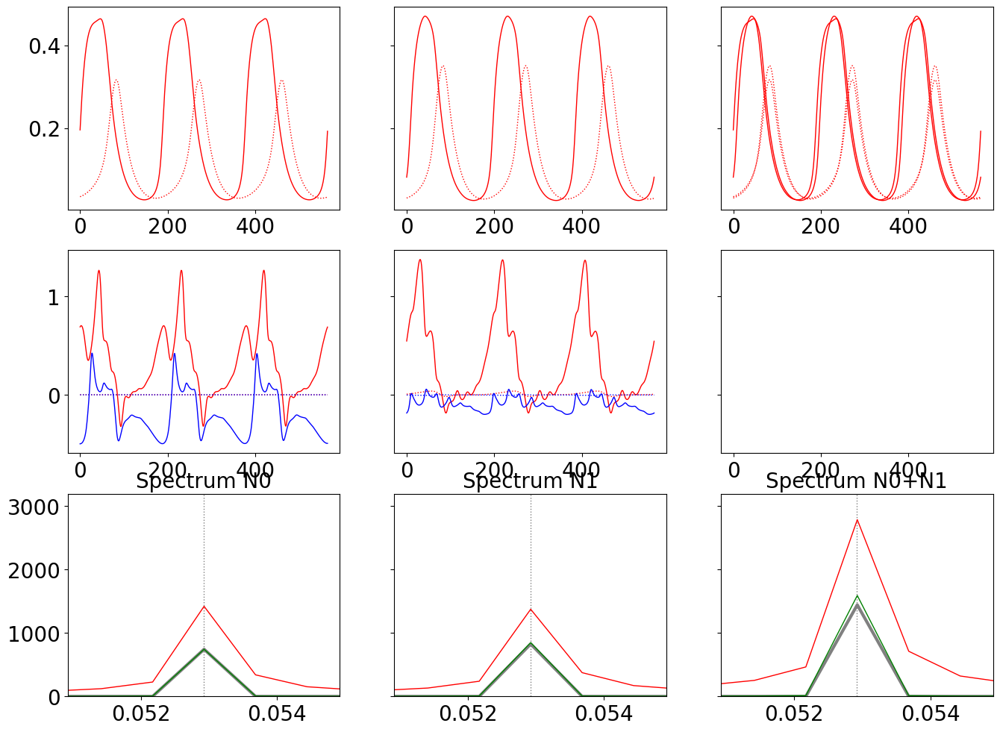

Compute control for a deterministic system
Cost in iteration 0: -0.17698388981007712
Converged in iteration 2 with cost -0.1769250178529112
Final cost : -0.1769250178529112
Compute control for a deterministic system
Cost in iteration 0: -0.1769250178529112
Converged in iteration 19 with cost -0.3295267622278711
Final cost : -0.3295267622278711
Compute control for a deterministic system
Cost in iteration 0: -0.3295267622278711
Converged in iteration 1 with cost -0.3295267622278711
Final cost : -0.3295267622278711
Compute control for a deterministic system
Cost in iteration 0: -0.3295267622278711
Converged in iteration 3 with cost -0.3425617852913958
Final cost : -0.3425617852913958


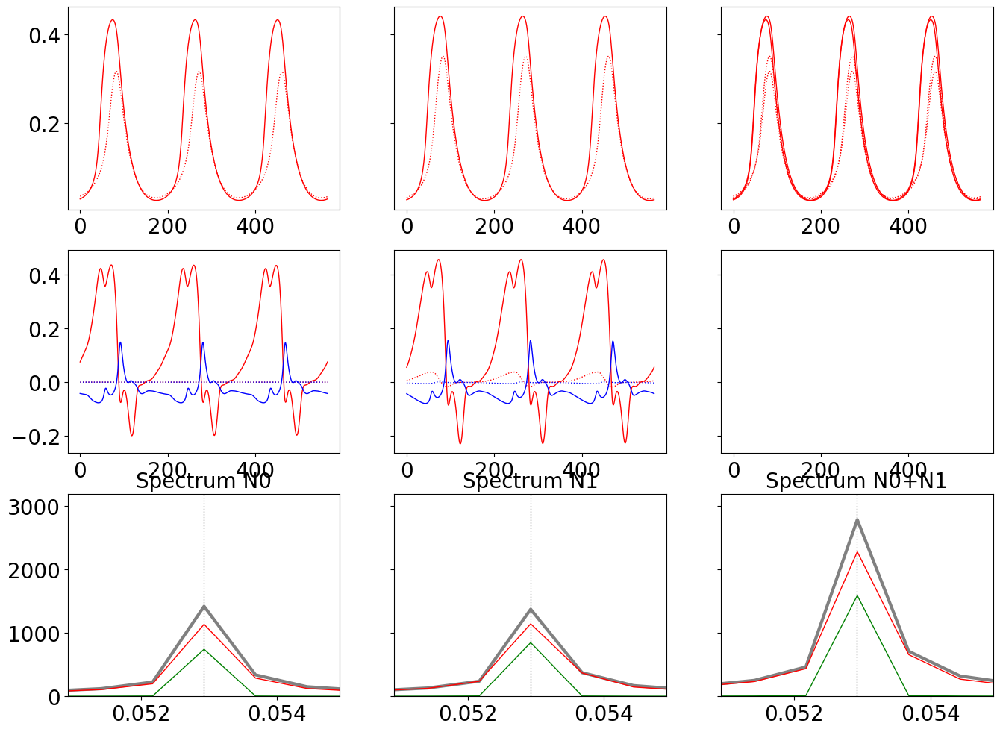

Compute control for a deterministic system
Cost in iteration 0: -0.17656509912006427
Converged in iteration 2 with cost -0.17650622716289835
Final cost : -0.17650622716289835
Compute control for a deterministic system
Cost in iteration 0: -0.17650622716289835
Converged in iteration 17 with cost -0.25035863017449905
Final cost : -0.25035863017449905
Compute control for a deterministic system
Cost in iteration 0: -0.25035863017449905
Converged in iteration 3 with cost -0.253000567077619
Final cost : -0.253000567077619
Compute control for a deterministic system
Cost in iteration 0: -0.253000567077619
Converged in iteration 2 with cost -0.253000567077619
Final cost : -0.253000567077619


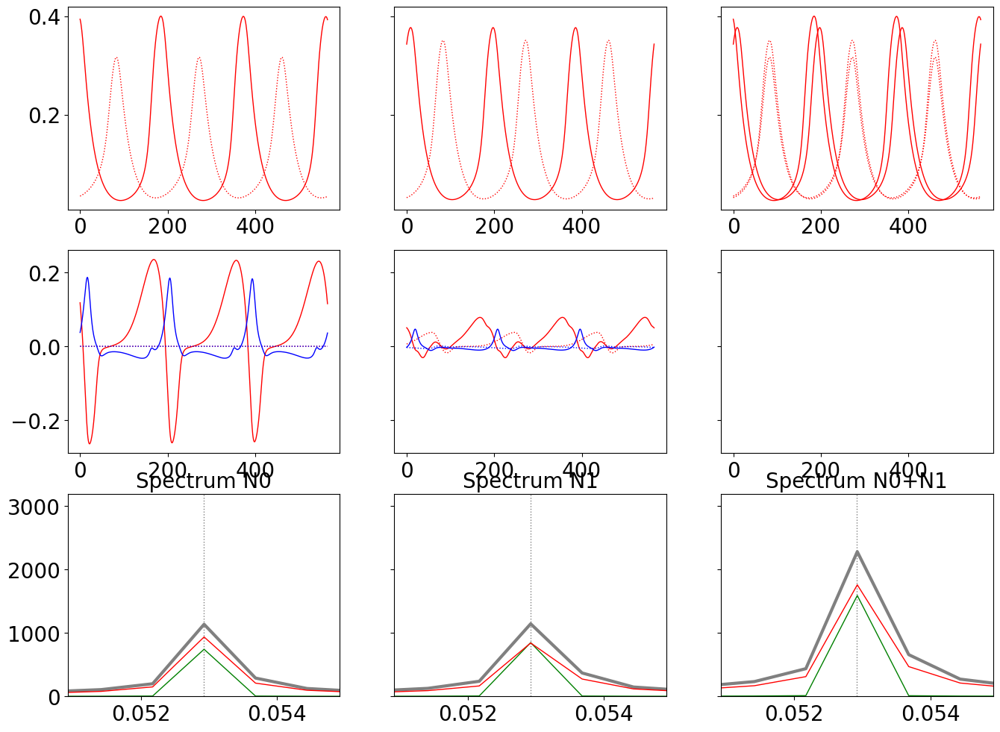

Compute control for a deterministic system
Cost in iteration 0: -0.17237719221993572
Converged in iteration 2 with cost -0.1723183202627698
Final cost : -0.1723183202627698
Compute control for a deterministic system
Cost in iteration 0: -0.1723183202627698
Converged in iteration 15 with cost -0.22795357715814654
Final cost : -0.22795357715814654
Compute control for a deterministic system
Cost in iteration 0: -0.22795357715814654
Converged in iteration 2 with cost -0.22795357715814654
Final cost : -0.22795357715814654
Compute control for a deterministic system
Cost in iteration 0: -0.22795357715814654
Converged in iteration 2 with cost -0.22795357715814654
Final cost : -0.22795357715814654


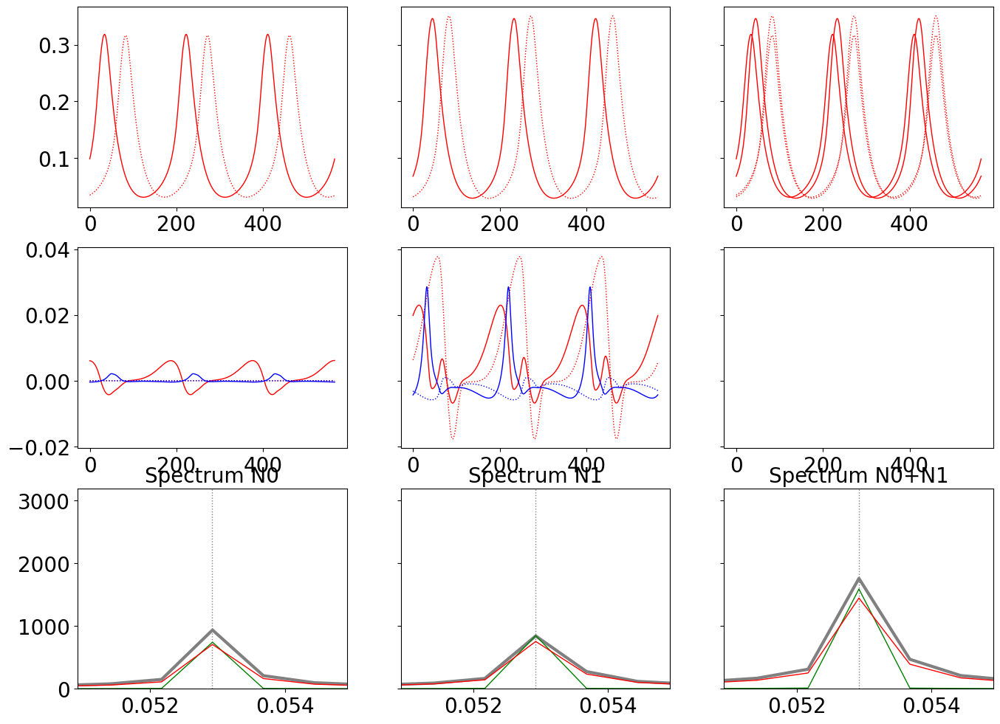

---------------------- 0 4
target period, max delay =  18.89583333333334 0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.20676027867603378
Converged in iteration 2 with cost -0.20633004451898276
Final cost : -0.20633004451898276
Compute control for a deterministic system
Cost in iteration 0: -0.20633004451898276
Cost in iteration 20: -0.4051502625741716
Converged in iteration 29 with cost -0.43030338549488456
Final cost : -0.43030338549488456
Compute control for a deterministic system
Cost in iteration 0: -0.43030338549488456
Converged in iteration 9 with cost -0.43382683990306325
Final cost : -0.43382683990306325
Compute control for a deterministic system
Cost in iteration 0: -0.43382683990306325
Converged in iteration 2 with cost -0.43382683990306325
Final cost : -0.43382683990306325


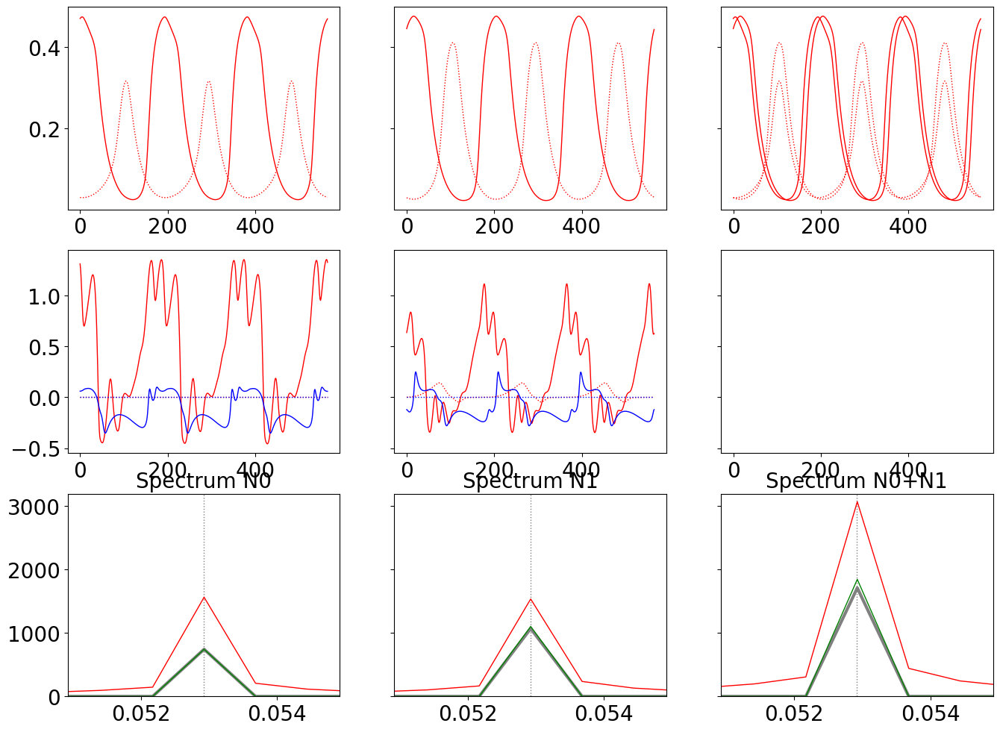

Compute control for a deterministic system
Cost in iteration 0: -0.20636827541681707
Converged in iteration 2 with cost -0.20593804125976606
Final cost : -0.20593804125976606
Compute control for a deterministic system
Cost in iteration 0: -0.20593804125976606
Cost in iteration 20: -0.35386231685231223
Converged in iteration 22 with cost -0.35911184094164905
Final cost : -0.35911184094164905
Compute control for a deterministic system
Cost in iteration 0: -0.35911184094164905
Converged in iteration 1 with cost -0.35911184094164905
Final cost : -0.35911184094164905
Compute control for a deterministic system
Cost in iteration 0: -0.35911184094164905
Converged in iteration 1 with cost -0.35911184094164905
Final cost : -0.35911184094164905


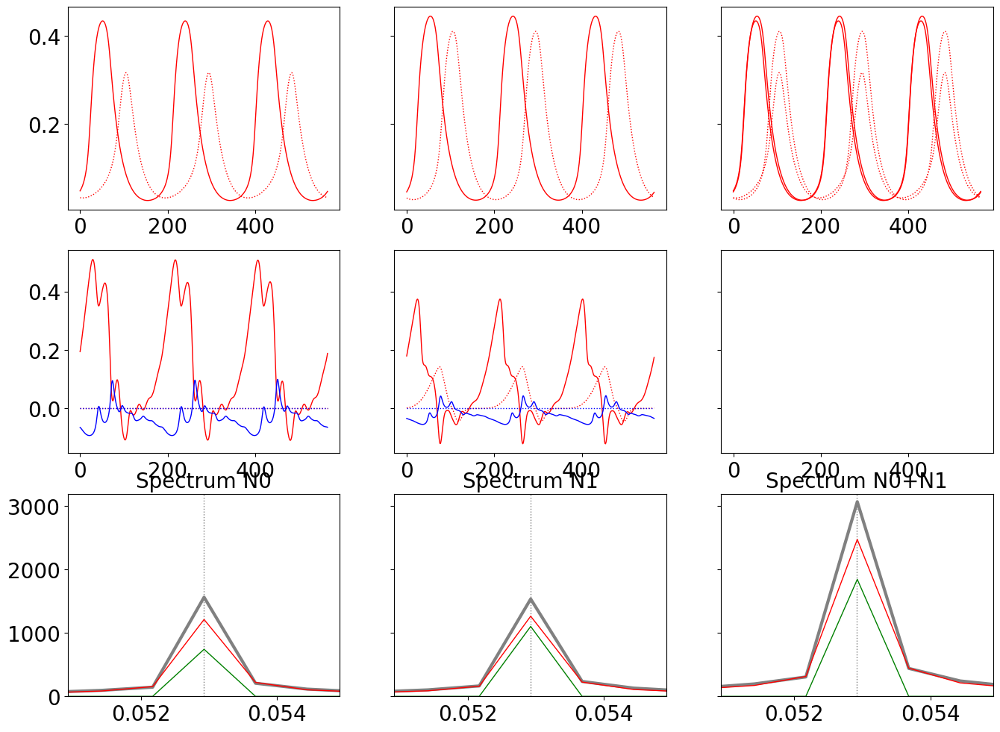

Compute control for a deterministic system
Cost in iteration 0: -0.2024482428246498
Converged in iteration 2 with cost -0.20201800866759878
Final cost : -0.20201800866759878
Compute control for a deterministic system
Cost in iteration 0: -0.20201800866759878
Converged in iteration 19 with cost -0.28820159196985373
Final cost : -0.28820159196985373
Compute control for a deterministic system
Cost in iteration 0: -0.28820159196985373
Converged in iteration 1 with cost -0.28820159196985373
Final cost : -0.28820159196985373
Compute control for a deterministic system
Cost in iteration 0: -0.28820159196985373
Converged in iteration 1 with cost -0.28820159196985373
Final cost : -0.28820159196985373


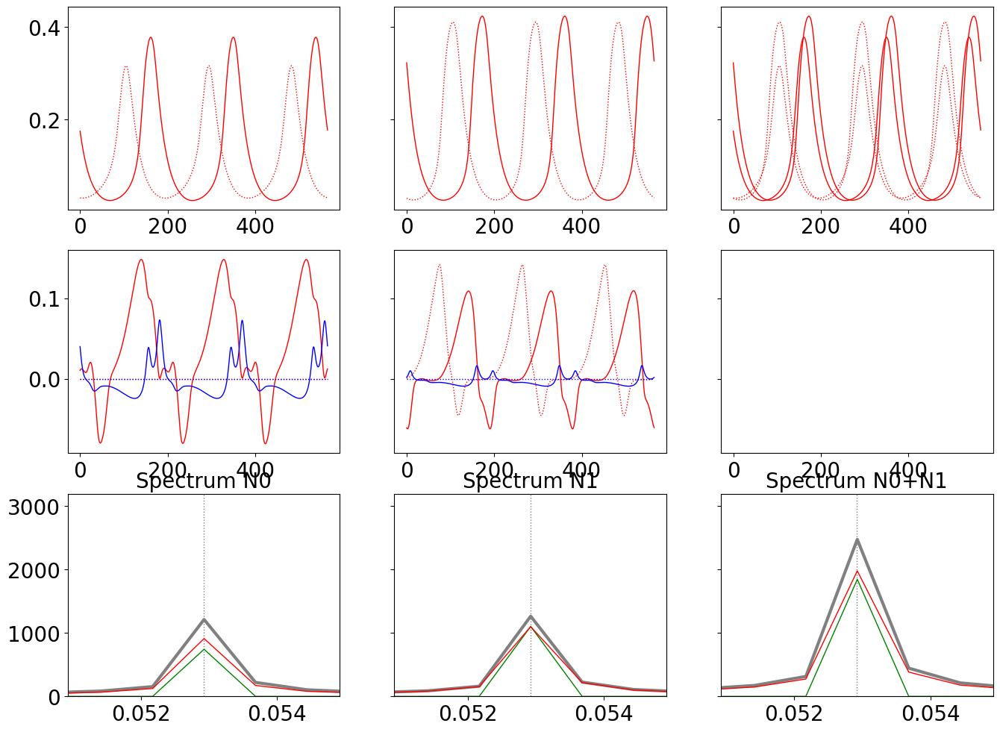

Compute control for a deterministic system
Cost in iteration 0: -0.16324791690297666
Converged in iteration 2 with cost -0.16281768274592565
Final cost : -0.16281768274592565
Compute control for a deterministic system
Cost in iteration 0: -0.16281768274592565
Converged in iteration 15 with cost -0.2557675040794801
Final cost : -0.2557675040794801
Compute control for a deterministic system
Cost in iteration 0: -0.2557675040794801
Converged in iteration 2 with cost -0.2557675040794801
Final cost : -0.2557675040794801
Compute control for a deterministic system
Cost in iteration 0: -0.2557675040794801
Converged in iteration 2 with cost -0.2557675040794801
Final cost : -0.2557675040794801


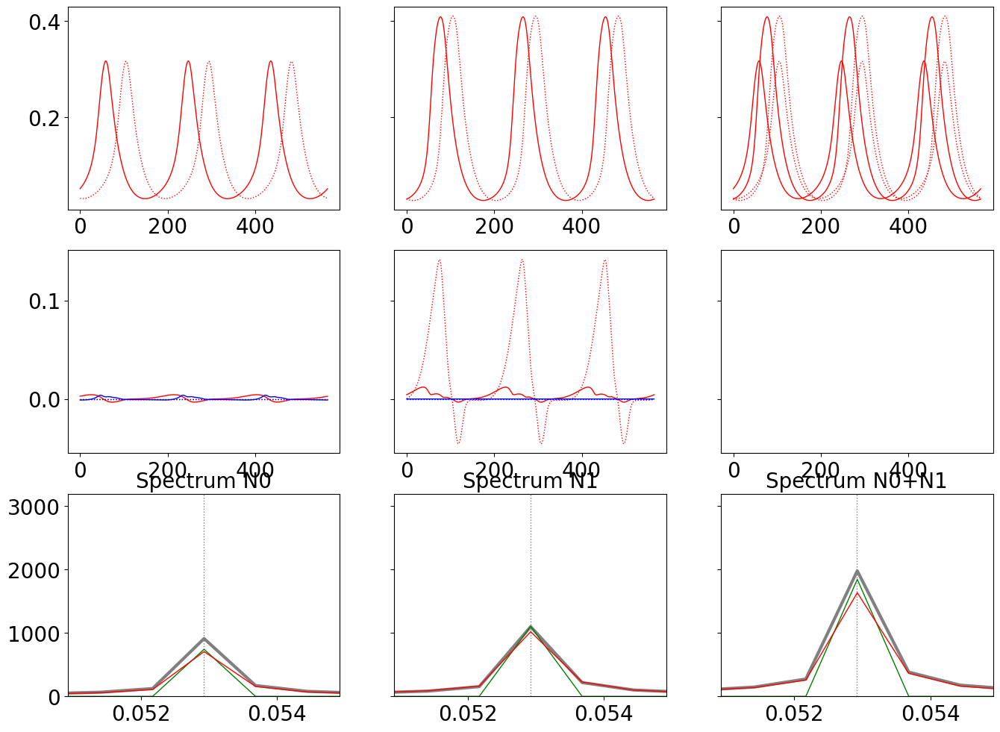

---------------------- 0 8
target period, max delay =  18.89583333333334 0
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.22039908102189848
Converged in iteration 2 with cost -0.22038644671362595
Final cost : -0.22038644671362595
Compute control for a deterministic system
Cost in iteration 0: -0.22038644671362595
Cost in iteration 20: -0.4202424602028097
Converged in iteration 24 with cost -0.4315401907586395
Final cost : -0.4315401907586395
Compute control for a deterministic system
Cost in iteration 0: -0.4315401907586395
Converged in iteration 9 with cost -0.434916881864388
Final cost : -0.434916881864388
Compute control for a deterministic system
Cost in iteration 0: -0.434916881864388
Converged in iteration 2 with cost -0.434916881864388
Final cost : -0.434916881864388


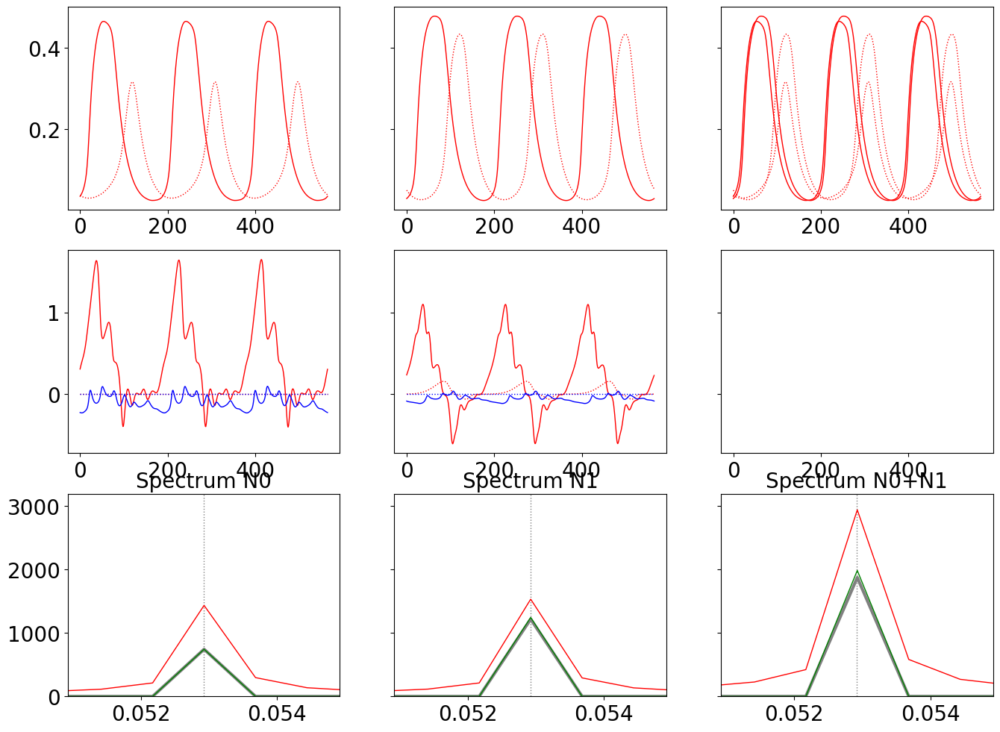

Compute control for a deterministic system
Cost in iteration 0: -0.21987665317823551
Converged in iteration 2 with cost -0.21986401886996298
Final cost : -0.21986401886996298
Compute control for a deterministic system
Cost in iteration 0: -0.21986401886996298
Cost in iteration 20: -0.3728207946269051
Converged in iteration 22 with cost -0.3728207946269051
Final cost : -0.3728207946269051
Compute control for a deterministic system
Cost in iteration 0: -0.3728207946269051
Converged in iteration 3 with cost -0.3729746083820267
Final cost : -0.3729746083820267
Compute control for a deterministic system
Cost in iteration 0: -0.3729746083820267
Converged in iteration 1 with cost -0.3729746083820267
Final cost : -0.3729746083820267


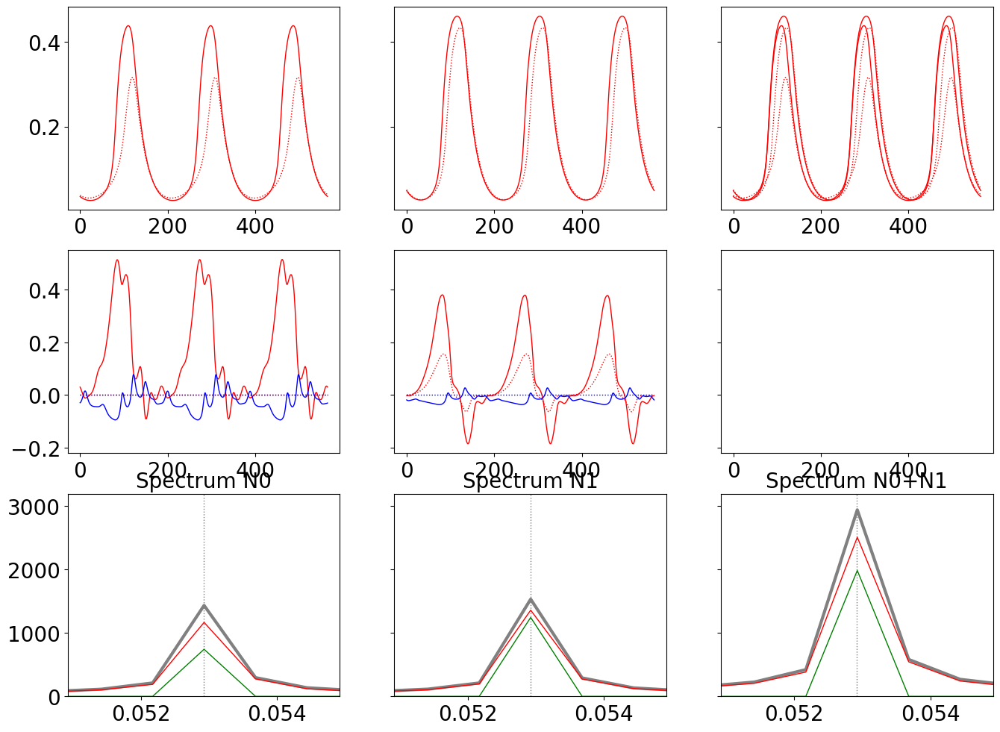

Compute control for a deterministic system
Cost in iteration 0: -0.21465237474160578
Converged in iteration 2 with cost -0.21463974043333325
Final cost : -0.21463974043333325
Compute control for a deterministic system
Cost in iteration 0: -0.21463974043333325
Cost in iteration 20: -0.302054799830695
Converged in iteration 27 with cost -0.30665661248903964
Final cost : -0.30665661248903964
Compute control for a deterministic system
Cost in iteration 0: -0.30665661248903964
Converged in iteration 3 with cost -0.3066734665532281
Final cost : -0.3066734665532281
Compute control for a deterministic system
Cost in iteration 0: -0.3066734665532281
Converged in iteration 1 with cost -0.3066734665532281
Final cost : -0.3066734665532281


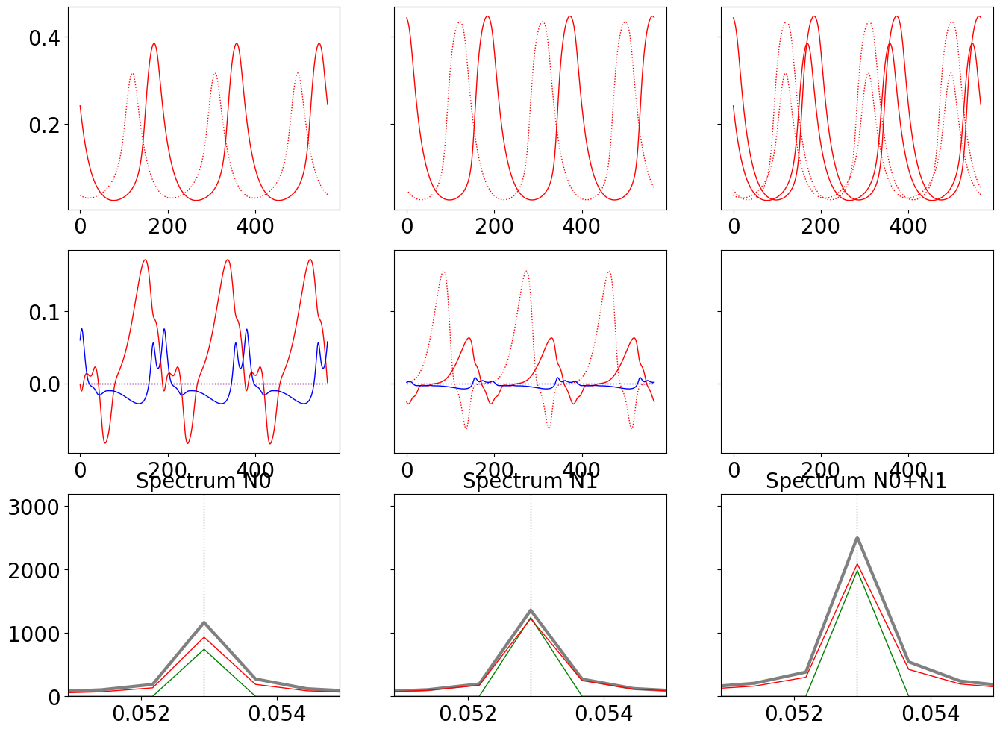

Compute control for a deterministic system
Cost in iteration 0: -0.16240959037530864
Converged in iteration 2 with cost -0.1623969560670361
Final cost : -0.1623969560670361
Compute control for a deterministic system
Cost in iteration 0: -0.1623969560670361
Converged in iteration 17 with cost -0.27961217691472917
Final cost : -0.27961217691472917
Compute control for a deterministic system
Cost in iteration 0: -0.27961217691472917
Converged in iteration 1 with cost -0.27961217691472917
Final cost : -0.27961217691472917
Compute control for a deterministic system
Cost in iteration 0: -0.27961217691472917
Converged in iteration 1 with cost -0.27961217691472917
Final cost : -0.27961217691472917


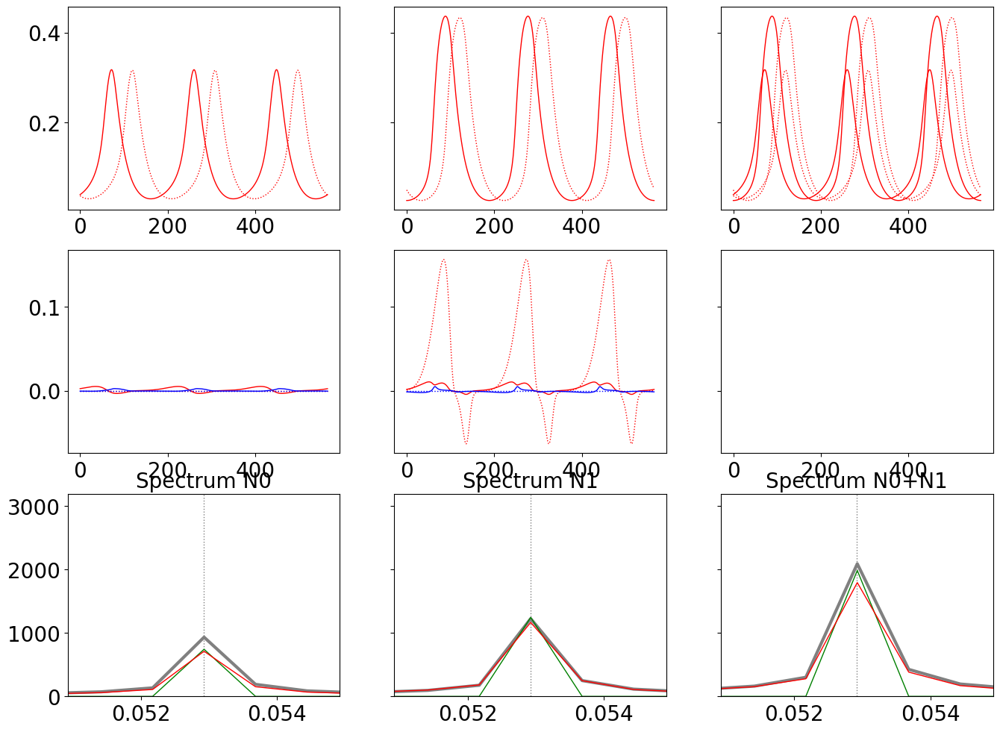

---------------------- 3 0
target period, max delay =  18.89583333333334 63
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.1609052366329176
Converged in iteration 2 with cost -0.16088219577656312
Final cost : -0.16088219577656312
Compute control for a deterministic system
Cost in iteration 0: -0.16088219577656312
Converged in iteration 8 with cost -0.16088407452656506
Final cost : -0.16088407452656506
Compute control for a deterministic system
Cost in iteration 0: -0.16088407452656506
Converged in iteration 1 with cost -0.16088407452656506
Final cost : -0.16088407452656506
Compute control for a deterministic system
Cost in iteration 0: -0.16088407452656506
Converged in iteration 13 with cost -0.39245183888933627
Final cost : -0.39245183888933627


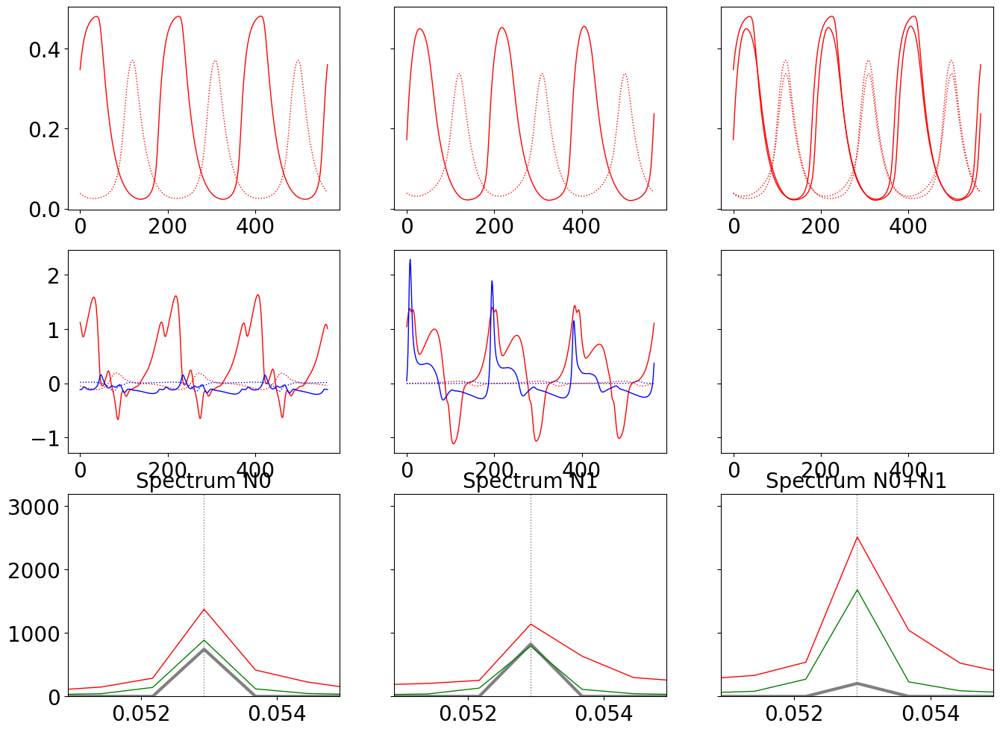

Compute control for a deterministic system
Cost in iteration 0: -0.1599593785397168
Converged in iteration 2 with cost -0.15993633768336235
Final cost : -0.15993633768336235
Compute control for a deterministic system
Cost in iteration 0: -0.15993633768336235
Converged in iteration 7 with cost -0.159936750700052
Final cost : -0.159936750700052
Compute control for a deterministic system
Cost in iteration 0: -0.159936750700052
Converged in iteration 2 with cost -0.159936750700052
Final cost : -0.159936750700052
Compute control for a deterministic system
Cost in iteration 0: -0.159936750700052
Converged in iteration 2 with cost -0.159936750700052
Final cost : -0.159936750700052


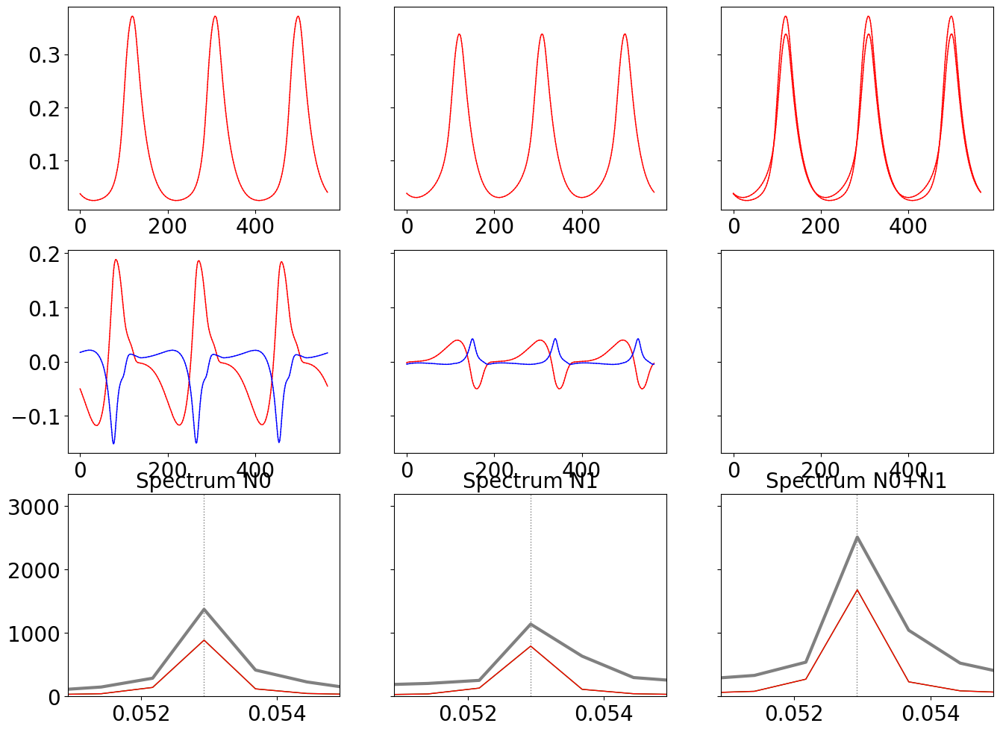

Compute control for a deterministic system
Cost in iteration 0: -0.15050079760770935
Converged in iteration 2 with cost -0.15047775675135489
Final cost : -0.15047775675135489
Compute control for a deterministic system
Cost in iteration 0: -0.15047775675135489
Converged in iteration 8 with cost -0.15048125339557683
Final cost : -0.15048125339557683
Compute control for a deterministic system
Cost in iteration 0: -0.15048125339557683
Converged in iteration 1 with cost -0.15048125339557683
Final cost : -0.15048125339557683
Compute control for a deterministic system
Cost in iteration 0: -0.15048125339557683
Converged in iteration 1 with cost -0.15048125339557683
Final cost : -0.15048125339557683


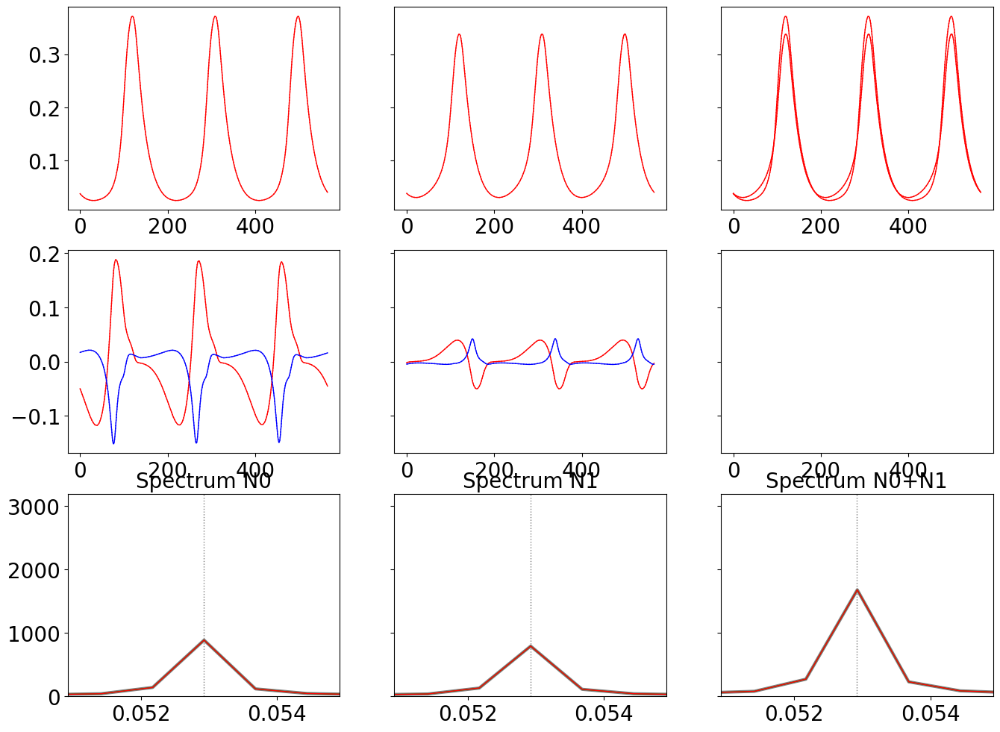

Compute control for a deterministic system
Cost in iteration 0: -0.05591498828763096
Converged in iteration 2 with cost -0.0558919474312765
Final cost : -0.0558919474312765
Compute control for a deterministic system
Cost in iteration 0: -0.0558919474312765
Converged in iteration 12 with cost -0.08407422858055236
Final cost : -0.08407422858055236
Compute control for a deterministic system
Cost in iteration 0: -0.08407422858055236
Converged in iteration 1 with cost -0.08407422858055236
Final cost : -0.08407422858055236
Compute control for a deterministic system
Cost in iteration 0: -0.08407422858055236
Converged in iteration 1 with cost -0.08407422858055236
Final cost : -0.08407422858055236


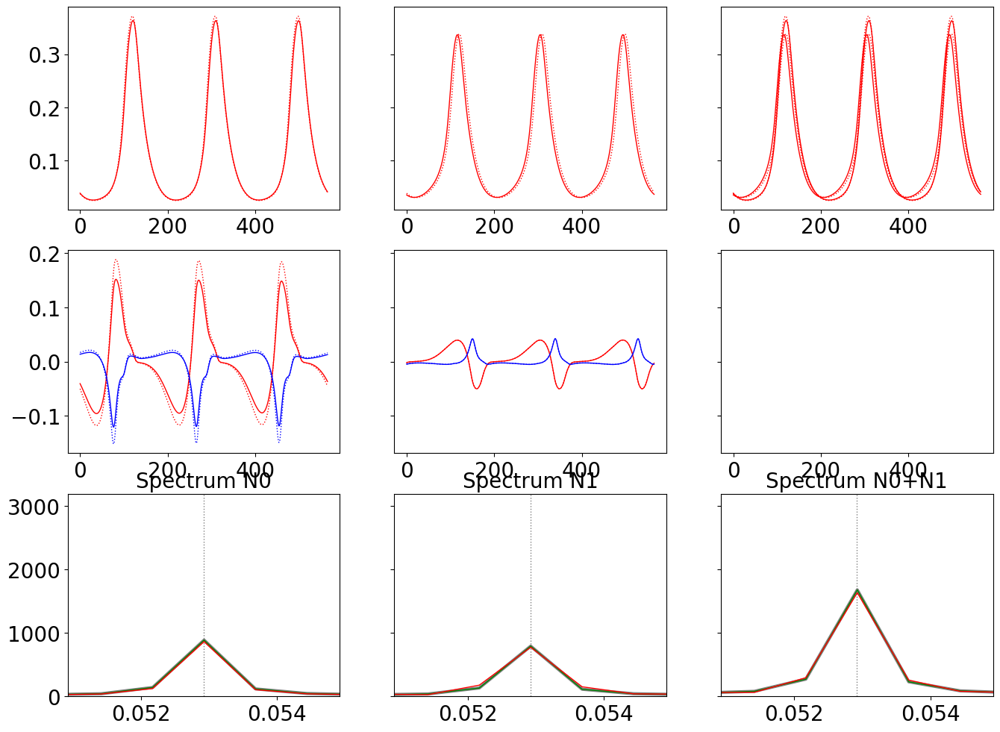

---------------------- 3 4
target period, max delay =  18.89583333333334 63
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.1982713005864472
Converged in iteration 2 with cost -0.1972919682029839
Final cost : -0.1972919682029839
Compute control for a deterministic system
Cost in iteration 0: -0.1972919682029839
Converged in iteration 15 with cost -0.20405722553046224
Final cost : -0.20405722553046224
Compute control for a deterministic system
Cost in iteration 0: -0.20405722553046224
Converged in iteration 1 with cost -0.20405722553046224
Final cost : -0.20405722553046224
Compute control for a deterministic system
Cost in iteration 0: -0.20405722553046224
Converged in iteration 1 with cost -0.20405722553046224
Final cost : -0.20405722553046224


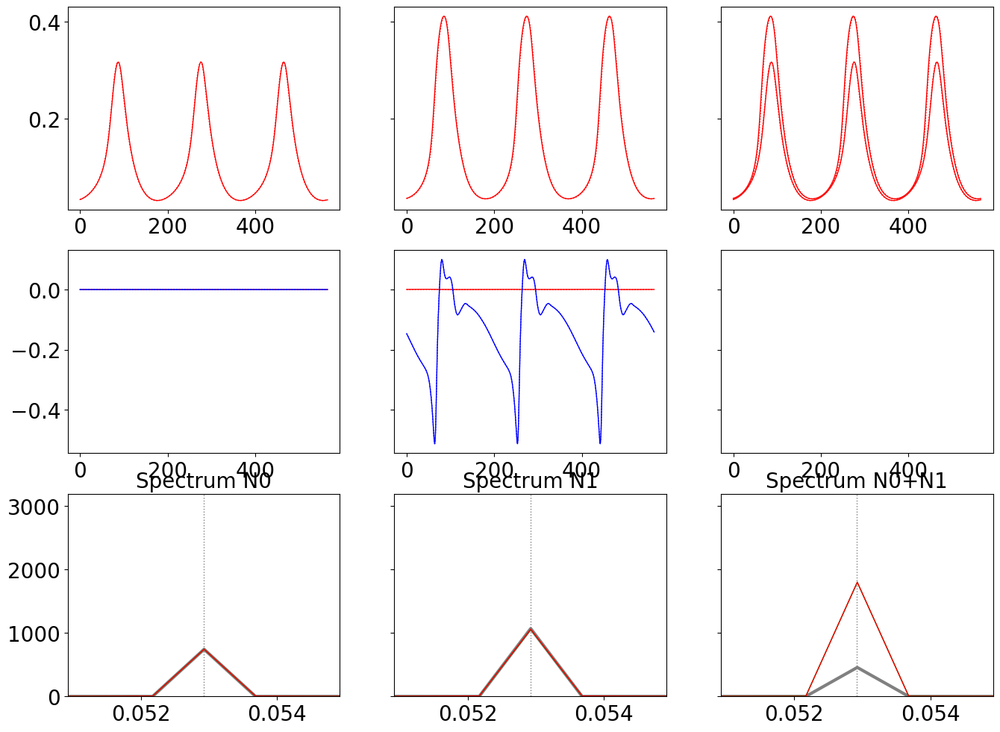

Compute control for a deterministic system
Cost in iteration 0: -0.19364366310336564
Converged in iteration 2 with cost -0.19266433071990233
Final cost : -0.19266433071990233
Compute control for a deterministic system
Cost in iteration 0: -0.19266433071990233
Converged in iteration 13 with cost -0.19944479772791282
Final cost : -0.19944479772791282
Compute control for a deterministic system
Cost in iteration 0: -0.19944479772791282
Converged in iteration 1 with cost -0.19944479772791282
Final cost : -0.19944479772791282
Compute control for a deterministic system
Cost in iteration 0: -0.19944479772791282
Converged in iteration 1 with cost -0.19944479772791282
Final cost : -0.19944479772791282


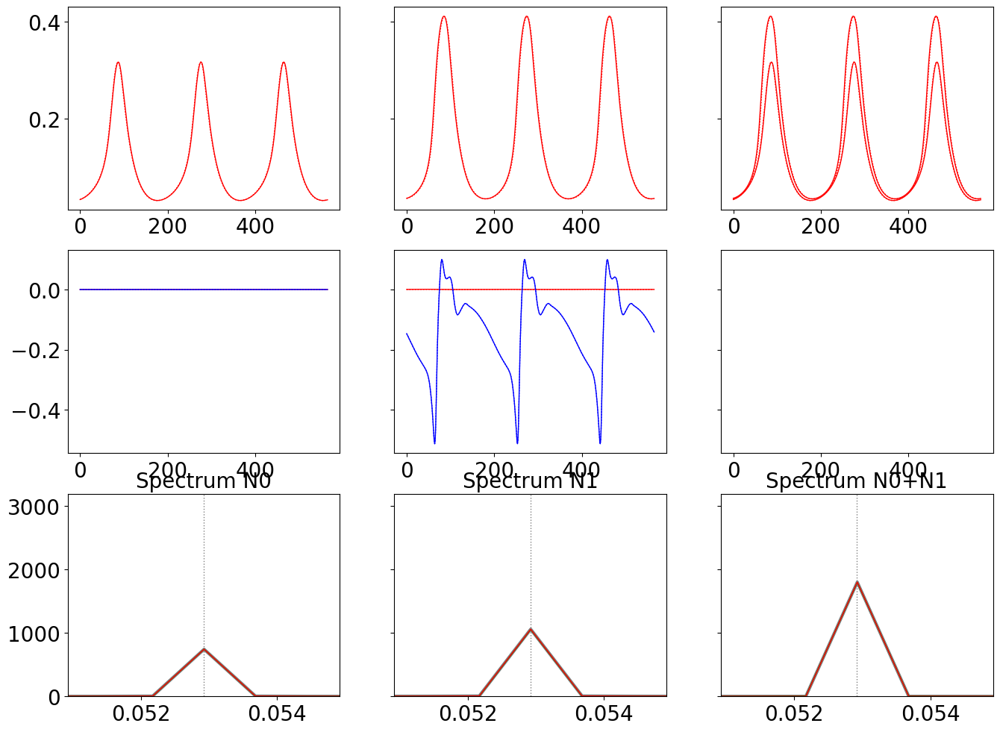

Compute control for a deterministic system
Cost in iteration 0: -0.14736728827254958
Converged in iteration 2 with cost -0.14638795588908626
Final cost : -0.14638795588908626
Compute control for a deterministic system
Cost in iteration 0: -0.14638795588908626
Converged in iteration 14 with cost -0.15312758237122925
Final cost : -0.15312758237122925
Compute control for a deterministic system
Cost in iteration 0: -0.15312758237122925
Converged in iteration 1 with cost -0.15312758237122925
Final cost : -0.15312758237122925
Compute control for a deterministic system
Cost in iteration 0: -0.15312758237122925
Converged in iteration 1 with cost -0.15312758237122925
Final cost : -0.15312758237122925


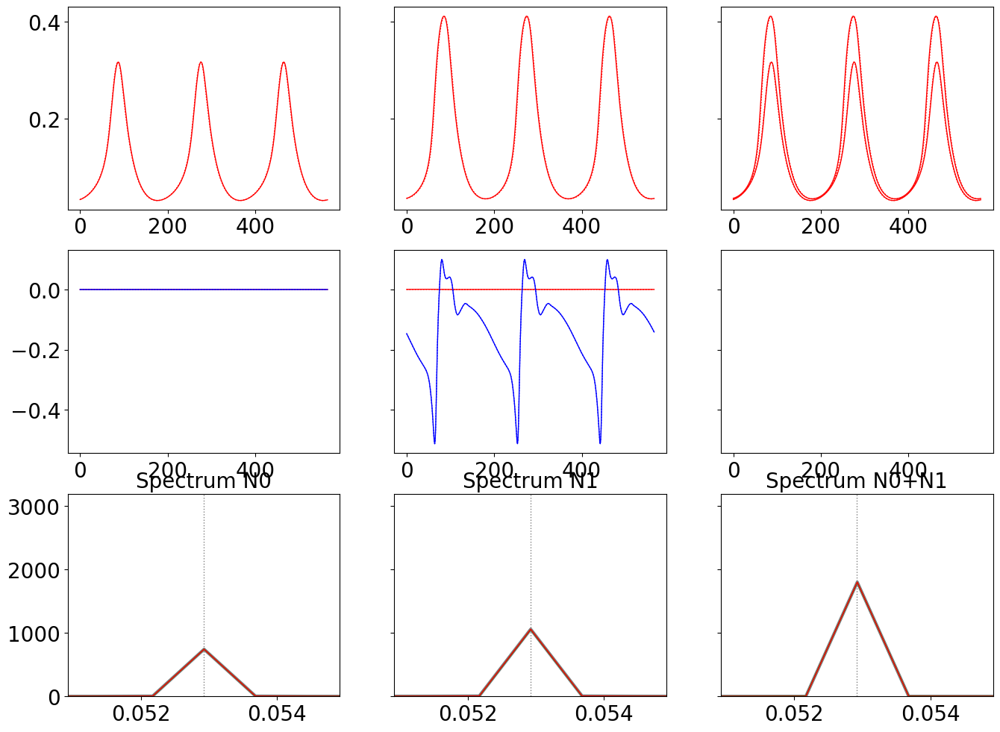

Compute control for a deterministic system
Cost in iteration 0: 0.31539646003560906
Converged in iteration 2 with cost 0.31637579241907243
Final cost : 0.31637579241907243
Compute control for a deterministic system
Cost in iteration 0: 0.31637579241907243
Converged in iteration 9 with cost 0.3092039656482138
Final cost : 0.3092039656482138
Compute control for a deterministic system
Cost in iteration 0: 0.3092039656482138
Converged in iteration 1 with cost 0.3092039656482138
Final cost : 0.3092039656482138
Compute control for a deterministic system
Cost in iteration 0: 0.3092039656482138
Converged in iteration 1 with cost 0.3092039656482138
Final cost : 0.3092039656482138


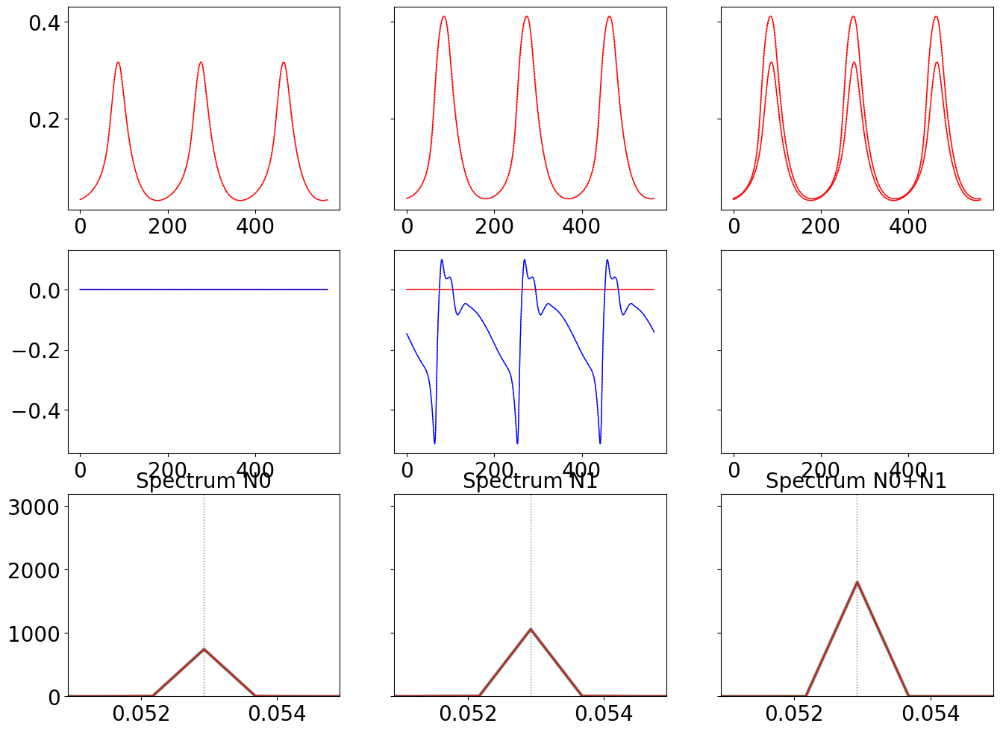

---------------------- 3 8
target period, max delay =  18.89583333333334 63
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.2168602445141161
Cost in iteration 20: -0.21786791087641225
Converged in iteration 31 with cost -0.2228262319436245
Final cost : -0.2228262319436245
Compute control for a deterministic system
Cost in iteration 0: -0.2228262319436245
Cost in iteration 20: -0.2251122168789905
Cost in iteration 40: -0.2305035228530916
Cost in iteration 60: -0.23152818801347363
Converged in iteration 61 with cost -0.23152818801347363
Final cost : -0.23152818801347363
Compute control for a deterministic system
Cost in iteration 0: -0.23152818801347363
Converged in iteration 1 with cost -0.23152818801347363
Final cost : -0.23152818801347363
Compute control for a deterministic system
Cost in iteration 0: -0.23152818801347363
Converged in iteration 1 with cost -0.23152818801347363
Final cost : -0.23152818801347363


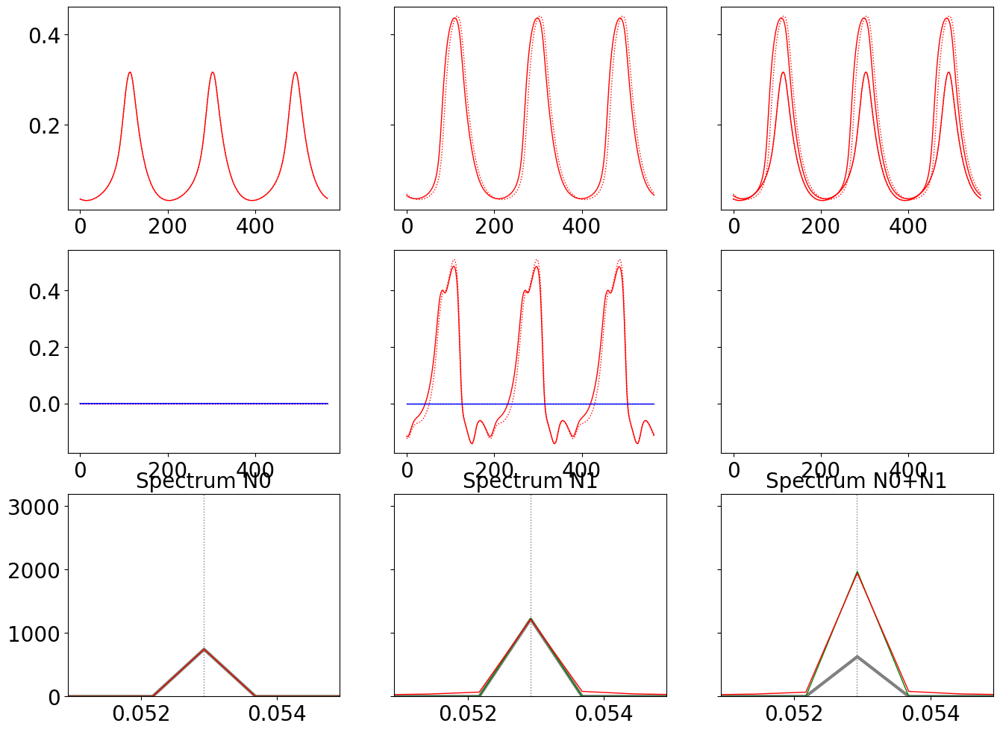

Compute control for a deterministic system
Cost in iteration 0: -0.20975229871857354
Cost in iteration 20: -0.2107577991322643
Converged in iteration 32 with cost -0.21287374977072657
Final cost : -0.21287374977072657
Compute control for a deterministic system
Cost in iteration 0: -0.21287374977072657
Cost in iteration 20: -0.21480406798856197
Cost in iteration 40: -0.21918539424763284
Cost in iteration 60: -0.22194495016340135
Converged in iteration 71 with cost -0.22270557396974738
Final cost : -0.22270557396974738
Compute control for a deterministic system
Cost in iteration 0: -0.22270557396974738
Converged in iteration 1 with cost -0.22270557396974738
Final cost : -0.22270557396974738
Compute control for a deterministic system
Cost in iteration 0: -0.22270557396974738
Converged in iteration 1 with cost -0.22270557396974738
Final cost : -0.22270557396974738


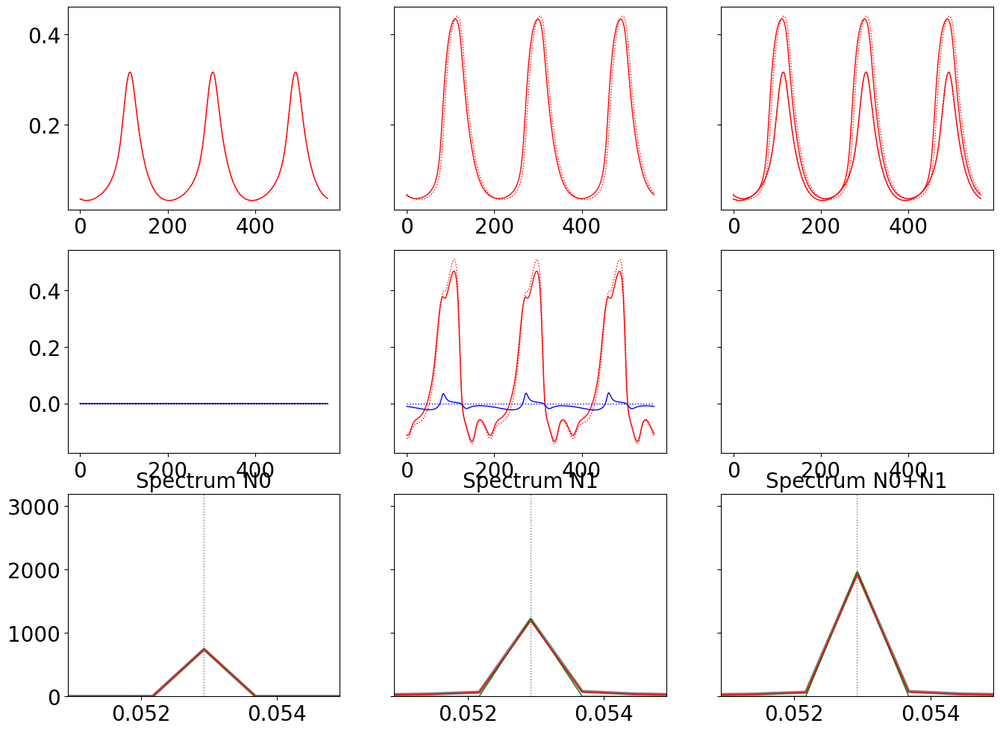

Compute control for a deterministic system
Cost in iteration 0: -0.13867284076314879
Cost in iteration 20: -0.13995134105765827
Cost in iteration 40: -0.16829574161574654
Cost in iteration 60: -0.17139048571320142
Converged in iteration 75 with cost -0.17182620669830848
Final cost : -0.17182620669830848
Compute control for a deterministic system
Cost in iteration 0: -0.17182620669830848
Converged in iteration 2 with cost -0.17182620669830848
Final cost : -0.17182620669830848
Compute control for a deterministic system
Cost in iteration 0: -0.17182620669830848
Converged in iteration 1 with cost -0.17182620669830848
Final cost : -0.17182620669830848
Compute control for a deterministic system
Cost in iteration 0: -0.17182620669830848
Converged in iteration 1 with cost -0.17182620669830848
Final cost : -0.17182620669830848


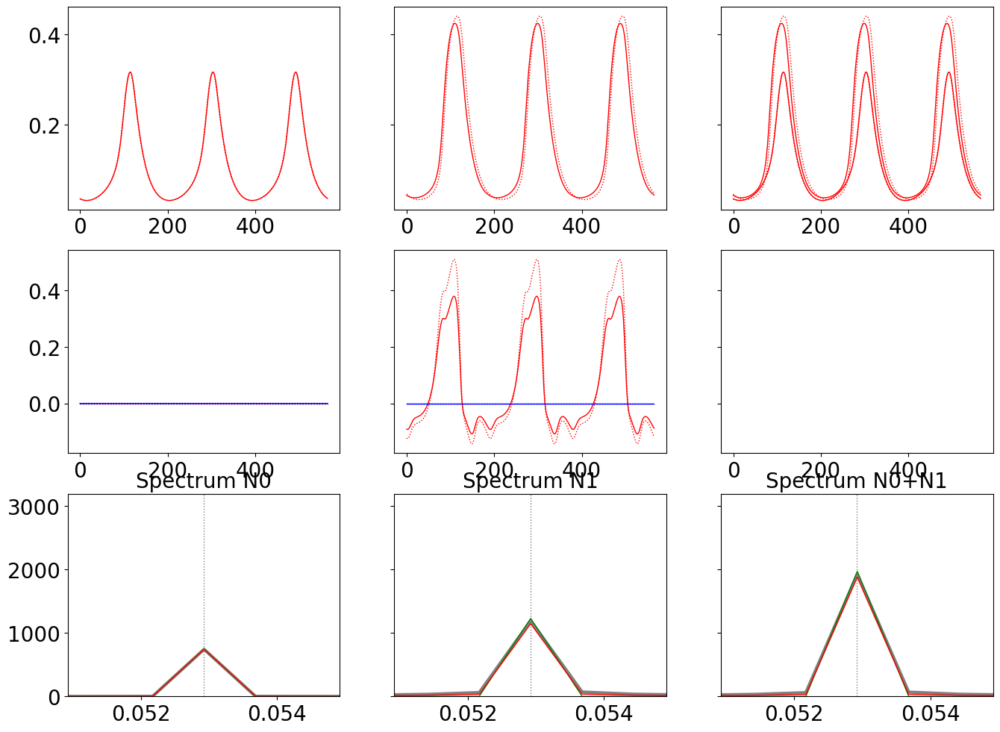

Compute control for a deterministic system
Cost in iteration 0: 0.5721217387911117
Cost in iteration 20: 0.5391608408170119
Cost in iteration 40: -0.09120266238828946
Converged in iteration 48 with cost -0.09132322599167712
Final cost : -0.09132322599167712
Compute control for a deterministic system
Cost in iteration 0: -0.09132322599167712
Converged in iteration 3 with cost -0.0913232273961301
Final cost : -0.0913232273961301
Compute control for a deterministic system
Cost in iteration 0: -0.0913232273961301
Converged in iteration 1 with cost -0.0913232273961301
Final cost : -0.0913232273961301
Compute control for a deterministic system
Cost in iteration 0: -0.0913232273961301
Converged in iteration 1 with cost -0.0913232273961301
Final cost : -0.0913232273961301


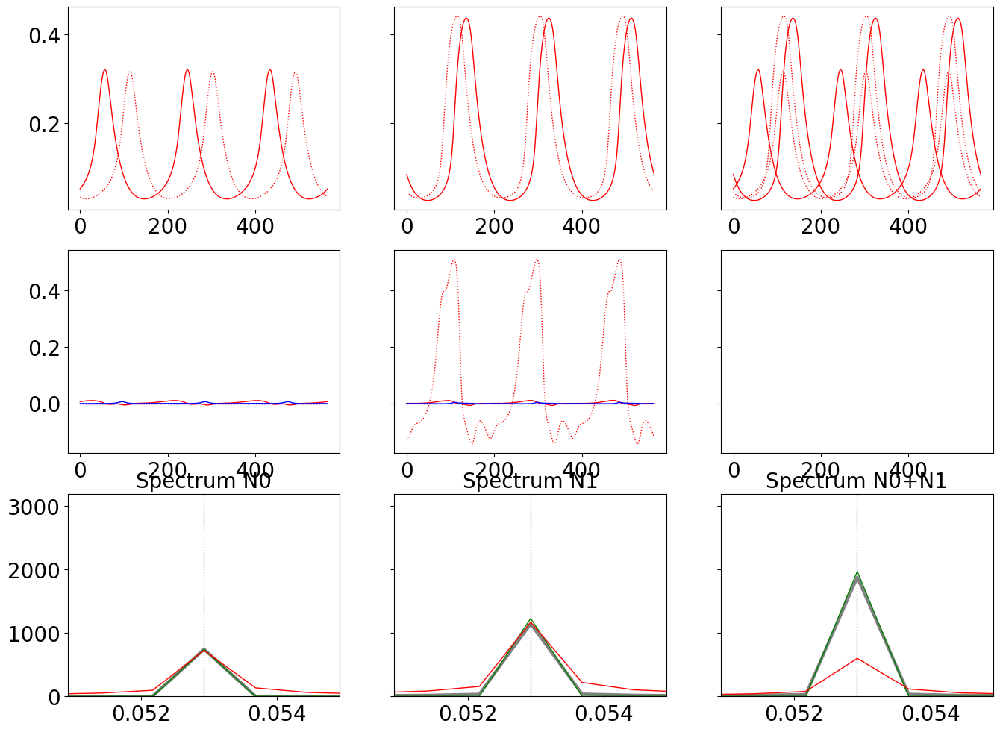

---------------------- 6 0
target period, max delay =  18.89583333333334 126
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.1878568500954489
Cost in iteration 20: -0.1913495284208934
Cost in iteration 40: -0.36988076672976256
Converged in iteration 52 with cost -0.3709113383074858
Final cost : -0.3709113383074858
Compute control for a deterministic system
Cost in iteration 0: -0.3709113383074858
Converged in iteration 15 with cost -0.37091998487817845
Final cost : -0.37091998487817845
Compute control for a deterministic system
Cost in iteration 0: -0.37091998487817845
Converged in iteration 1 with cost -0.37091998487817845
Final cost : -0.37091998487817845
Compute control for a deterministic system
Cost in iteration 0: -0.37091998487817845
Converged in iteration 1 with cost -0.37091998487817845
Final cost : -0.37091998487817845


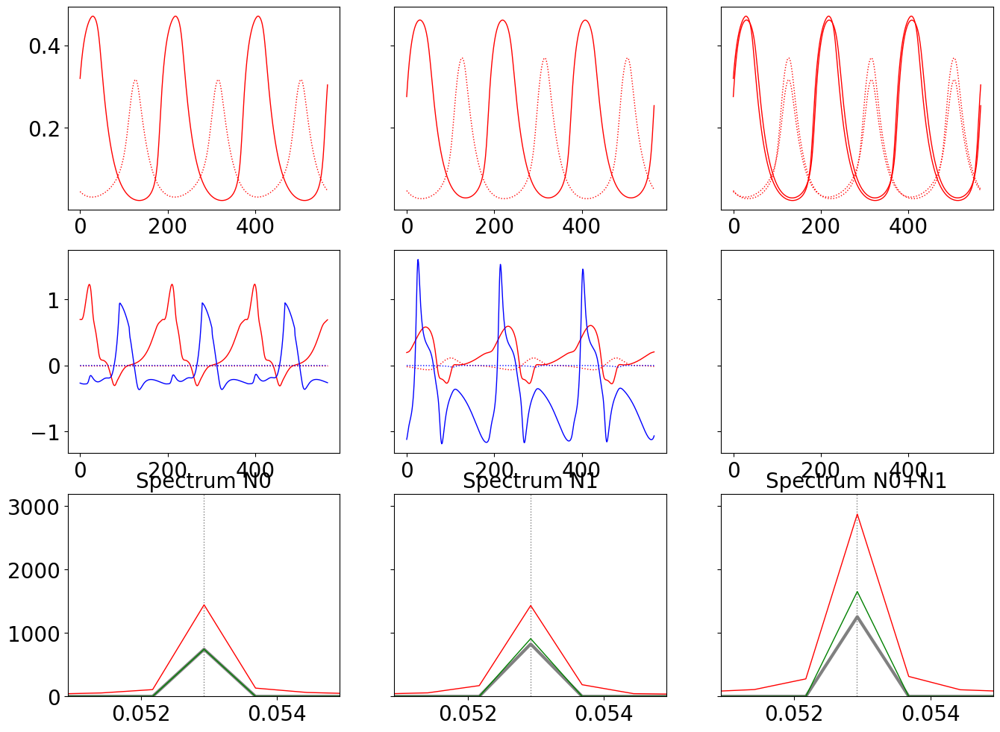

Compute control for a deterministic system
Cost in iteration 0: -0.18749031017914153
Cost in iteration 20: -0.19098249462234043
Converged in iteration 34 with cost -0.25712760298970827
Final cost : -0.25712760298970827
Compute control for a deterministic system
Cost in iteration 0: -0.25712760298970827
Converged in iteration 10 with cost -0.25712945562454054
Final cost : -0.25712945562454054
Compute control for a deterministic system
Cost in iteration 0: -0.25712945562454054
Converged in iteration 2 with cost -0.25712945562454054
Final cost : -0.25712945562454054
Compute control for a deterministic system
Cost in iteration 0: -0.25712945562454054
Converged in iteration 2 with cost -0.25712945562454054
Final cost : -0.25712945562454054


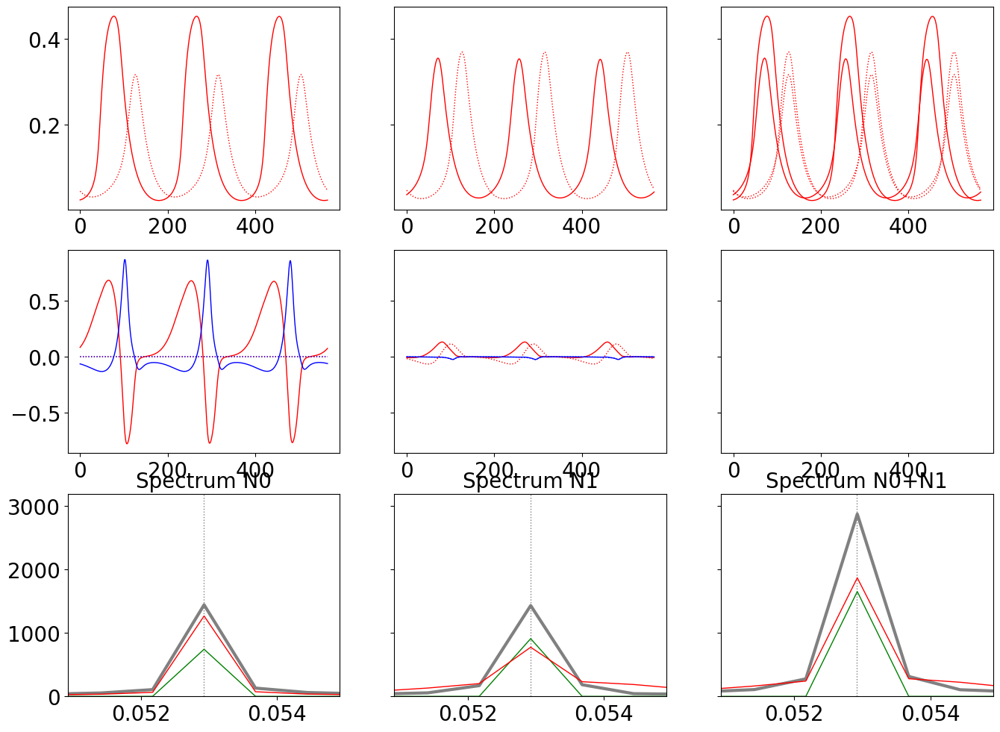

Compute control for a deterministic system
Cost in iteration 0: -0.18382491101606802
Cost in iteration 20: -0.1873268642605616
Converged in iteration 39 with cost -0.2228596532974031
Final cost : -0.2228596532974031
Compute control for a deterministic system
Cost in iteration 0: -0.2228596532974031
Converged in iteration 1 with cost -0.2228596532974031
Final cost : -0.2228596532974031
Compute control for a deterministic system
Cost in iteration 0: -0.2228596532974031
Converged in iteration 1 with cost -0.2228596532974031
Final cost : -0.2228596532974031
Compute control for a deterministic system
Cost in iteration 0: -0.2228596532974031
Converged in iteration 1 with cost -0.2228596532974031
Final cost : -0.2228596532974031


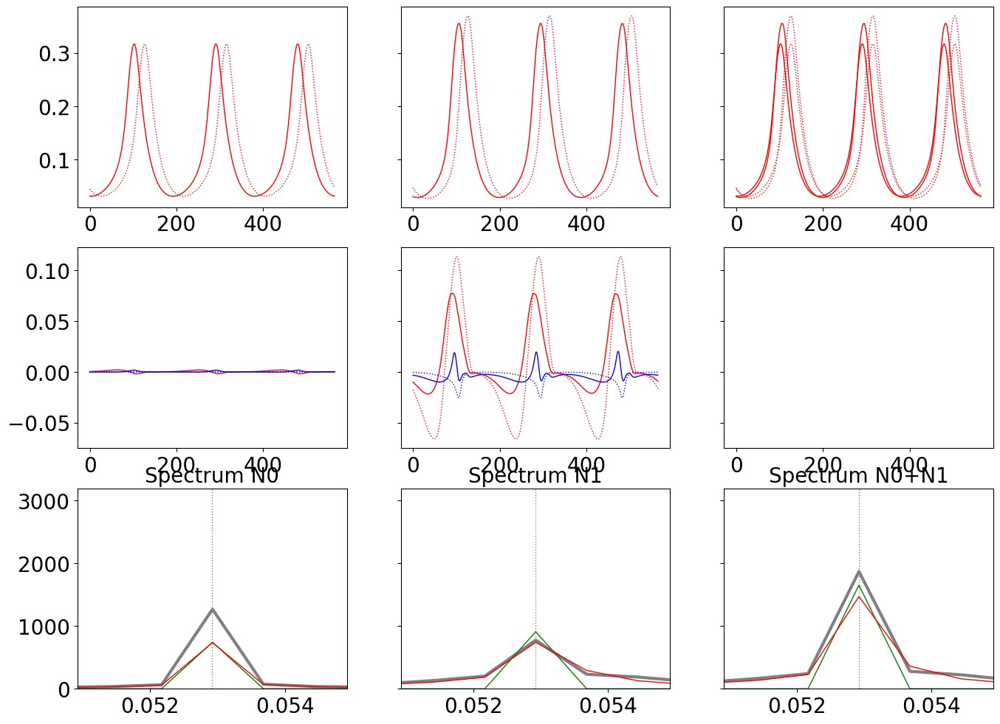

Compute control for a deterministic system
Cost in iteration 0: -0.14717091938533297
Cost in iteration 20: -0.15221646272514922
Converged in iteration 29 with cost -0.19284229651686086
Final cost : -0.19284229651686086
Compute control for a deterministic system
Cost in iteration 0: -0.19284229651686086
Converged in iteration 1 with cost -0.19284229651686086
Final cost : -0.19284229651686086
Compute control for a deterministic system
Cost in iteration 0: -0.19284229651686086
Converged in iteration 1 with cost -0.19284229651686086
Final cost : -0.19284229651686086
Compute control for a deterministic system
Cost in iteration 0: -0.19284229651686086
Converged in iteration 1 with cost -0.19284229651686086
Final cost : -0.19284229651686086


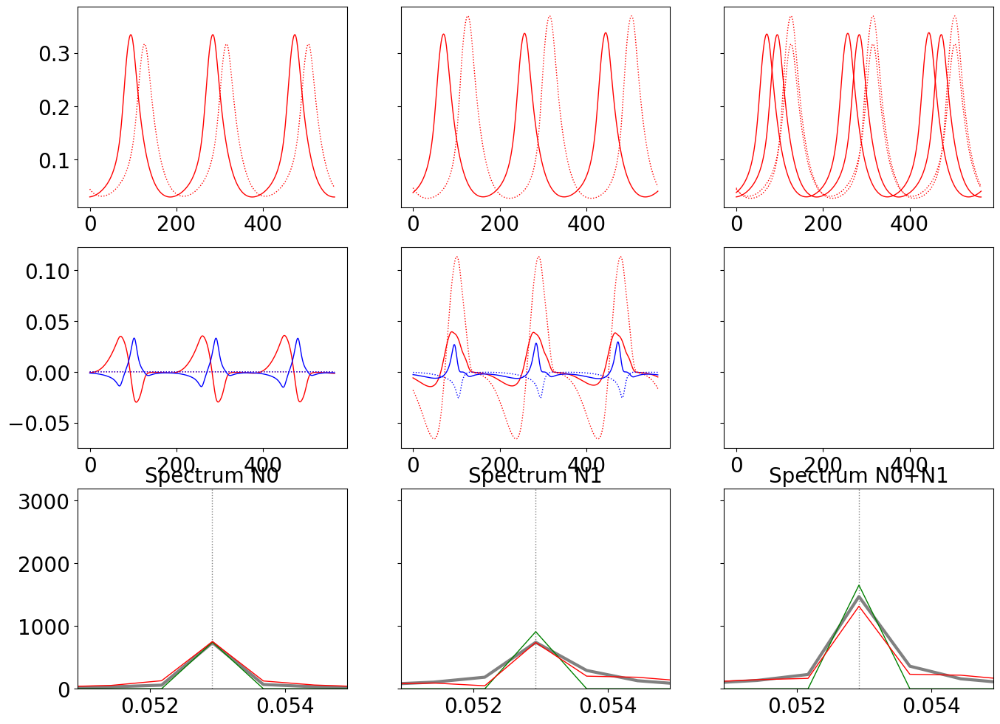

---------------------- 6 4
target period, max delay =  18.89583333333334 126
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.22922803401070446
Cost in iteration 20: -0.23060773891959568
Converged in iteration 32 with cost -0.24849180102302004
Final cost : -0.24849180102302004
Compute control for a deterministic system
Cost in iteration 0: -0.24849180102302004
Converged in iteration 1 with cost -0.24849180102302004
Final cost : -0.24849180102302004
Compute control for a deterministic system
Cost in iteration 0: -0.24849180102302004
Converged in iteration 1 with cost -0.24849180102302004
Final cost : -0.24849180102302004
Compute control for a deterministic system
Cost in iteration 0: -0.24849180102302004
Converged in iteration 1 with cost -0.24849180102302004
Final cost : -0.24849180102302004


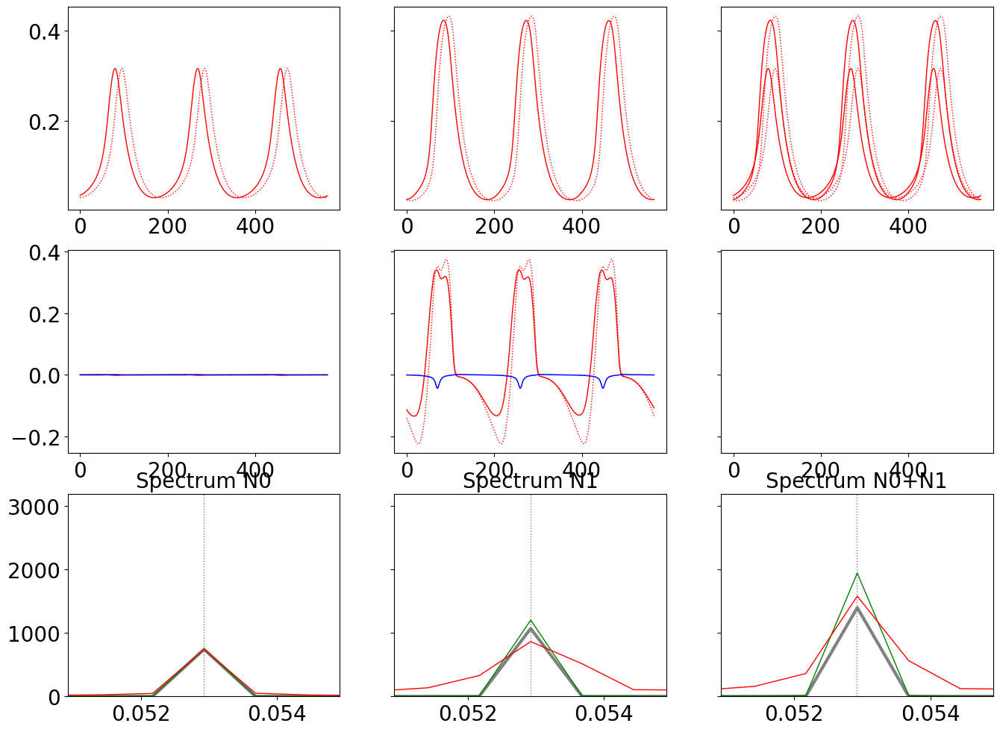

Compute control for a deterministic system
Cost in iteration 0: -0.22459217201668152
Cost in iteration 20: -0.22597254237904735
Converged in iteration 33 with cost -0.23833297989373603
Final cost : -0.23833297989373603
Compute control for a deterministic system
Cost in iteration 0: -0.23833297989373603
Converged in iteration 1 with cost -0.23833297989373603
Final cost : -0.23833297989373603
Compute control for a deterministic system
Cost in iteration 0: -0.23833297989373603
Converged in iteration 1 with cost -0.23833297989373603
Final cost : -0.23833297989373603
Compute control for a deterministic system
Cost in iteration 0: -0.23833297989373603
Converged in iteration 1 with cost -0.23833297989373603
Final cost : -0.23833297989373603


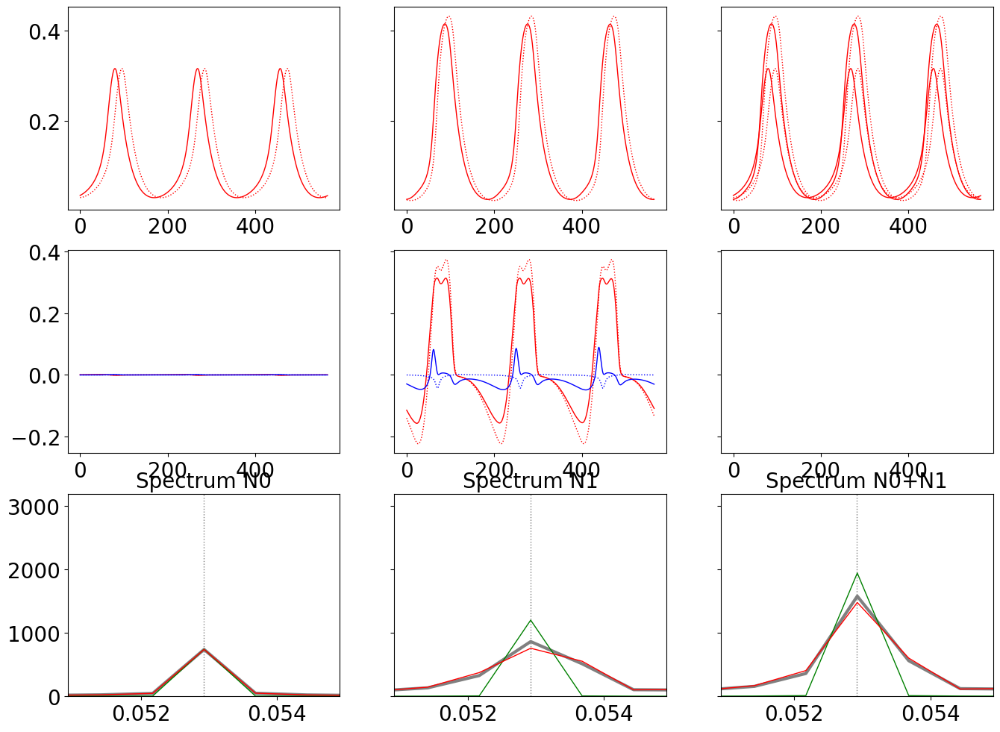

Compute control for a deterministic system
Cost in iteration 0: -0.17823355207645195
Cost in iteration 20: -0.1798107483510711
Converged in iteration 30 with cost -0.20396347679231433
Final cost : -0.20396347679231433
Compute control for a deterministic system
Cost in iteration 0: -0.20396347679231433
Converged in iteration 1 with cost -0.20396347679231433
Final cost : -0.20396347679231433
Compute control for a deterministic system
Cost in iteration 0: -0.20396347679231433
Converged in iteration 1 with cost -0.20396347679231433
Final cost : -0.20396347679231433
Compute control for a deterministic system
Cost in iteration 0: -0.20396347679231433
Converged in iteration 1 with cost -0.20396347679231433
Final cost : -0.20396347679231433


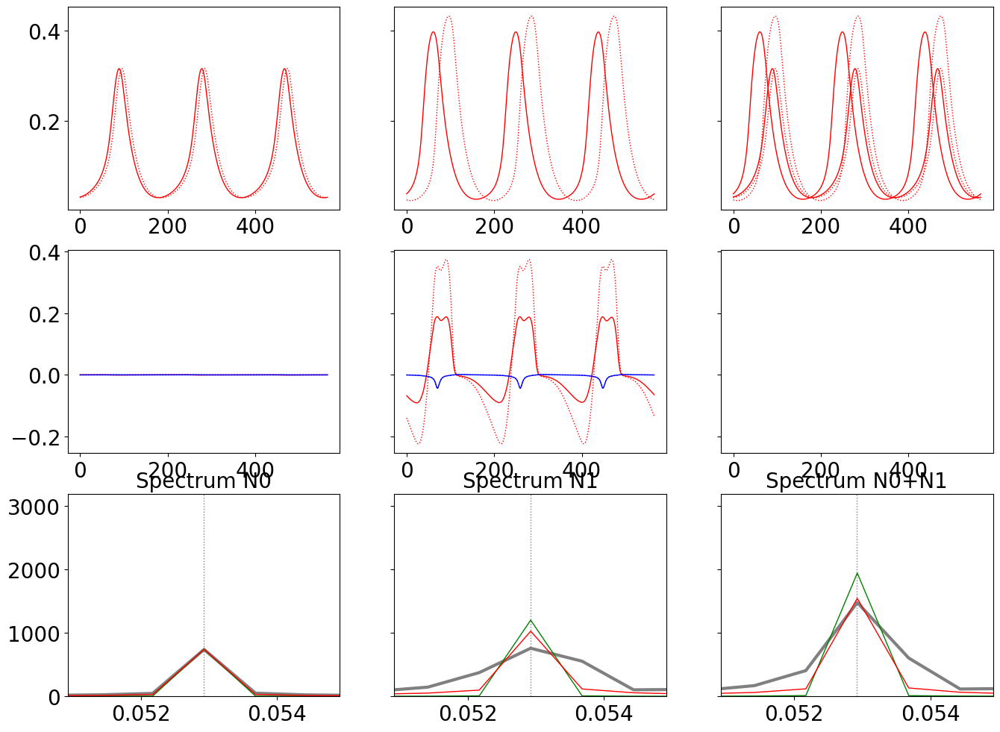

Compute control for a deterministic system
Cost in iteration 0: 0.2853526473258395
Cost in iteration 20: 0.26298770756120765
Converged in iteration 39 with cost -0.21224776199158463
Final cost : -0.21224776199158463
Compute control for a deterministic system
Cost in iteration 0: -0.21224776199158463
Converged in iteration 2 with cost -0.21224776199158463
Final cost : -0.21224776199158463
Compute control for a deterministic system
Cost in iteration 0: -0.21224776199158463
Converged in iteration 1 with cost -0.21224776199158463
Final cost : -0.21224776199158463
Compute control for a deterministic system
Cost in iteration 0: -0.21224776199158463
Converged in iteration 1 with cost -0.21224776199158463
Final cost : -0.21224776199158463


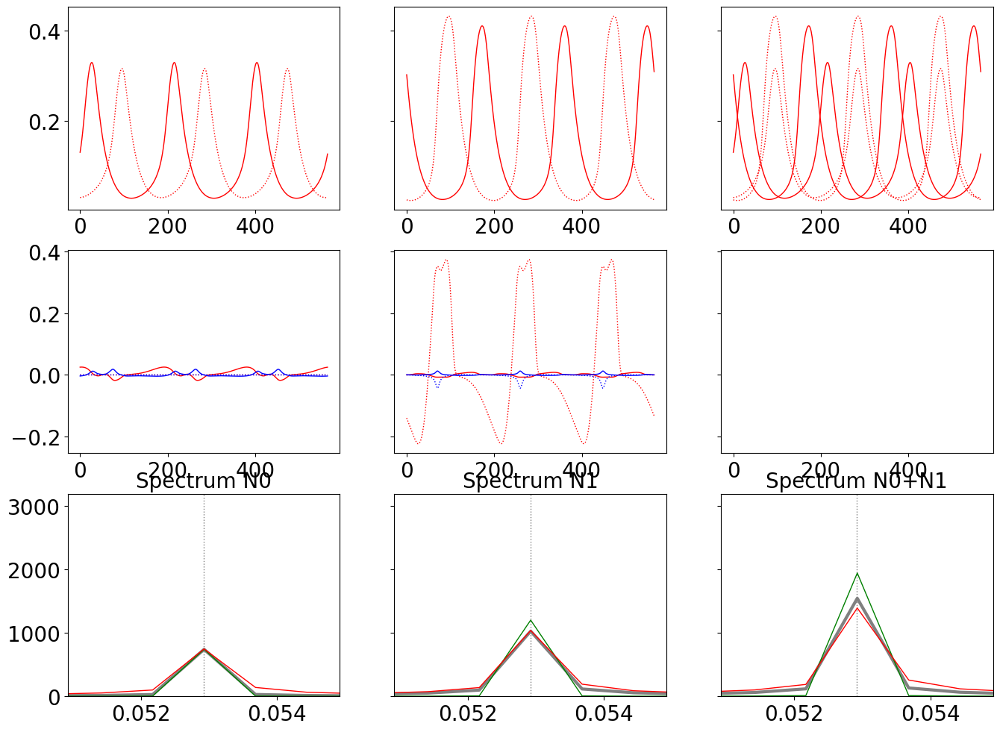

---------------------- 6 8
target period, max delay =  18.89583333333334 126
Optimal control with target oscillation period
Compute control for a deterministic system
Cost in iteration 0: -0.24435493995509444
Cost in iteration 20: -0.2447710676358886
Converged in iteration 27 with cost -0.255289463872598
Final cost : -0.255289463872598
Compute control for a deterministic system
Cost in iteration 0: -0.255289463872598
Converged in iteration 1 with cost -0.255289463872598
Final cost : -0.255289463872598
Compute control for a deterministic system
Cost in iteration 0: -0.255289463872598
Converged in iteration 1 with cost -0.255289463872598
Final cost : -0.255289463872598
Compute control for a deterministic system
Cost in iteration 0: -0.255289463872598
Converged in iteration 1 with cost -0.255289463872598
Final cost : -0.255289463872598


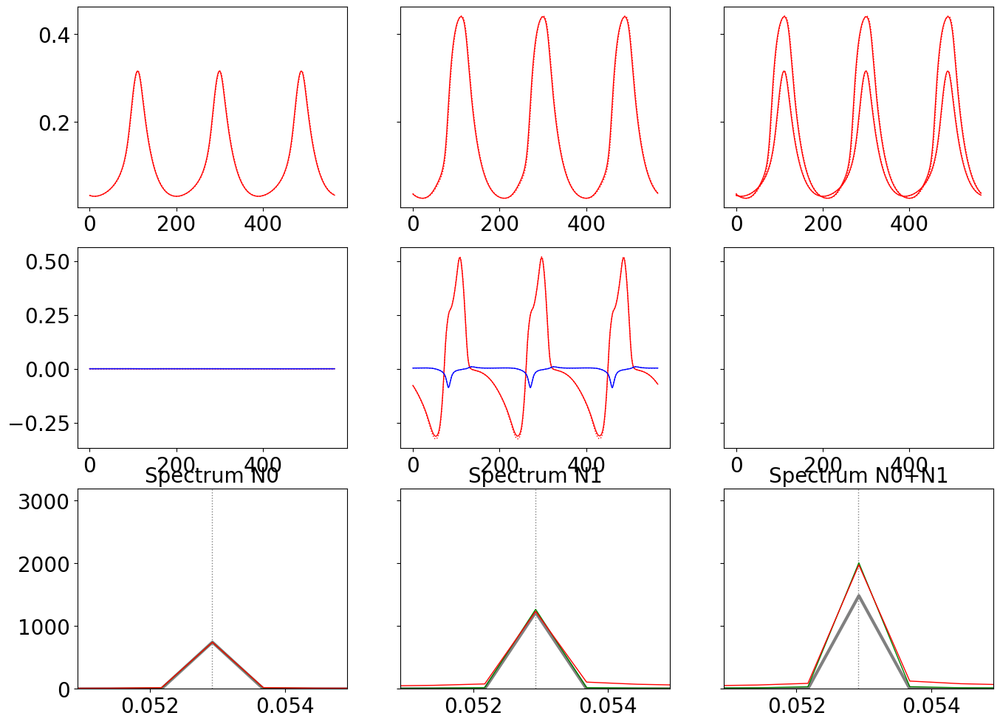

Compute control for a deterministic system
Cost in iteration 0: -0.23765586596611196
Cost in iteration 20: -0.23808483787845572
Converged in iteration 27 with cost -0.24622790039044828
Final cost : -0.24622790039044828
Compute control for a deterministic system
Cost in iteration 0: -0.24622790039044828
Converged in iteration 1 with cost -0.24622790039044828
Final cost : -0.24622790039044828
Compute control for a deterministic system
Cost in iteration 0: -0.24622790039044828
Converged in iteration 1 with cost -0.24622790039044828
Final cost : -0.24622790039044828
Compute control for a deterministic system
Cost in iteration 0: -0.24622790039044828
Converged in iteration 1 with cost -0.24622790039044828
Final cost : -0.24622790039044828


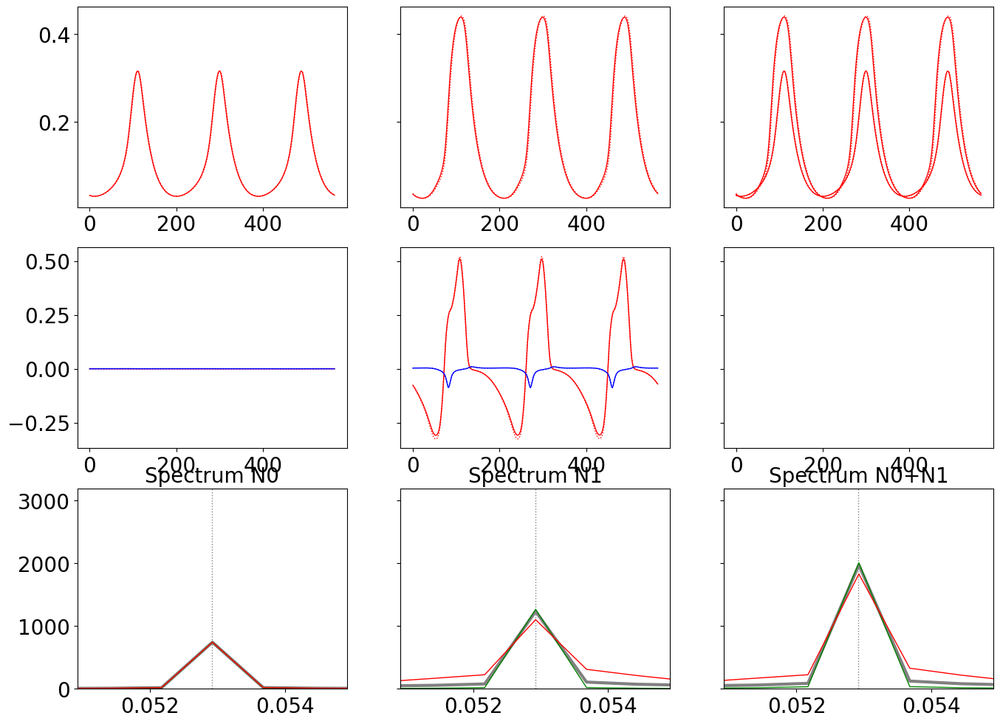

Compute control for a deterministic system
Cost in iteration 0: -0.17066512607628737
Cost in iteration 20: -0.17149885400464449
Converged in iteration 27 with cost -0.19324180681689307
Final cost : -0.19324180681689307
Compute control for a deterministic system
Cost in iteration 0: -0.19324180681689307
Converged in iteration 1 with cost -0.19324180681689307
Final cost : -0.19324180681689307
Compute control for a deterministic system
Cost in iteration 0: -0.19324180681689307
Converged in iteration 14 with cost -0.20264511697090448
Final cost : -0.20264511697090448
Compute control for a deterministic system
Cost in iteration 0: -0.20264511697090448
Converged in iteration 2 with cost -0.20264511697090448
Final cost : -0.20264511697090448


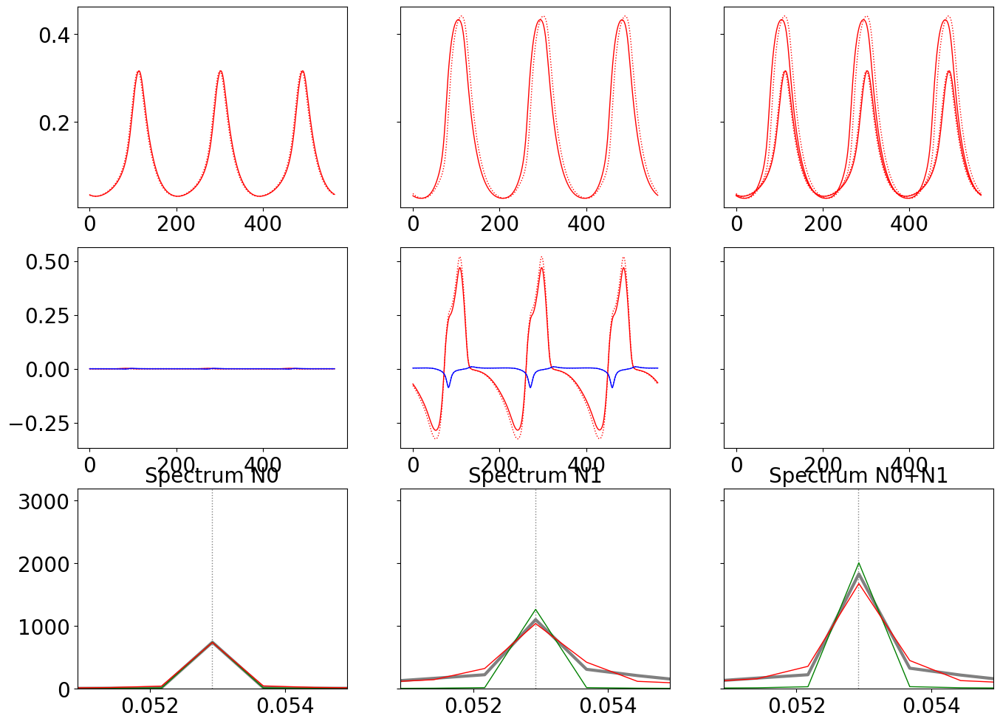

Compute control for a deterministic system
Cost in iteration 0: 0.4992422728219523
Cost in iteration 20: 0.46715593599425875
Converged in iteration 35 with cost -0.22627157403211712
Final cost : -0.22627157403211712
Compute control for a deterministic system
Cost in iteration 0: -0.22627157403211712
Converged in iteration 1 with cost -0.22627157403211712
Final cost : -0.22627157403211712
Compute control for a deterministic system
Cost in iteration 0: -0.22627157403211712
Converged in iteration 1 with cost -0.22627157403211712
Final cost : -0.22627157403211712
Compute control for a deterministic system
Cost in iteration 0: -0.22627157403211712
Converged in iteration 1 with cost -0.22627157403211712
Final cost : -0.22627157403211712


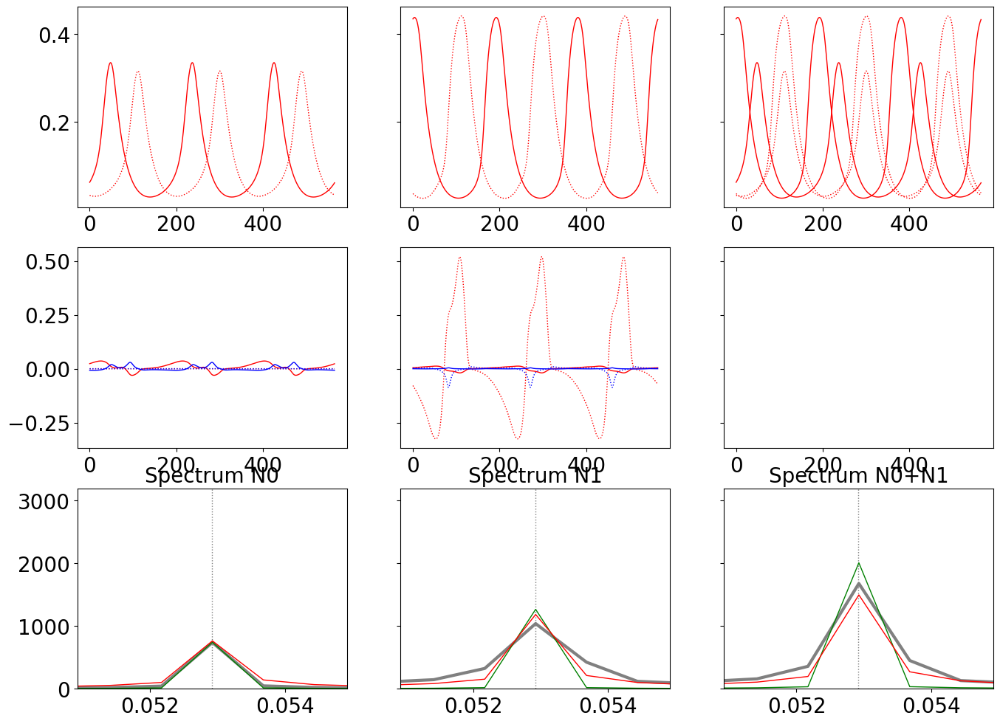

cmat i =  1


In [27]:
# is CC solution also a solution of F?
cmats = []
cmats.append(np.array( [[0., 0.], [1., 0.]] ))
cmats.append(np.array( [[0., 1.], [1., 0.]] ))
maxstr = 5.
it = 100

costmat = np.zeros((N, 2))
costmat[:,0] = 1.
controlmat = np.ones((N,2))

pr = np.arange(0,1001,20)

w2 = 1.

for i in range(len(cmats)):
    print("cmat i = ", i)

    if i not in [0]: continue

    pname = "E"
    p = data[pname]["coordinates"]

    for di in range(len(delay_array)):

        for ci in range(len(coupling_array)):
            
            if ci not in [0, 4, 8]: continue
            if di not in [0, 3, 6]: continue

            print("----------------------", di, ci)

            target_period = data[pname]["natural_period"][i][di][ci]

            dmat = delay_array[di] * cmats[i] * 20. # multiply with signal V
            model = WCModel(Cmat=cmats[i], Dmat=dmat)
            nmaxdelay = model.getMaxDelay()
            print("target period, max delay = ", target_period, nmaxdelay)
        
            model.params["exc_ext_baseline"] =  p[0]
            model.params["inh_ext_baseline"] =  p[1]

            model.params.K_gl = coupling_array[ci]

            duration = 3000.

            zero_input0 = ZeroInput().generate_input(duration=duration+model.params.dt, dt=model.params.dt)
            zero_input = np.vstack( ([zero_input0]*2) )[np.newaxis,:,:]
            zero_control = np.vstack( ([zero_input]*N))
                
            model.params.duration = duration
            model.params["exc_ext"] = zero_control[:,0,:]
            model.params["inh_ext"] = zero_control[:,1,:]
            model.params["exc_init"] = data[pname]["init_state"][i][di][ci][0]
            model.params["inh_init"] = data[pname]["init_state"][i][di][ci][1]
            model.run()

            ######### plot power spectrum of undisturbed osc
            i0 = 8000
            i1 = i0+int(70*target_period/dt)
            ft = np.abs( [ np.fft.rfft(model.exc[0,i0:i1]), np.fft.rfft(model.exc[1,i0:i1]), np.fft.rfft(model.exc[0,i0:i1] + model.exc[1,i0:i1]) ] )
            frequency = np.linspace(0, (1./dt)/2, len(ft[0]))

            int0 = 600
            int1 = int0 + int(145*target_period/dt)

            model_controlled = oc_wc.OcWc(model, target_period, print_array=pr, cost_interval=(int0,None), control_interval=(int0, int1), cost_matrix=costmat, control_matrix=controlmat)
            model_controlled.channelwise_optimization = True
            model_controlled.weights["w_p"] = 0.
            model_controlled.weights["w_f_sync"] = 1.
            model_controlled.weights["w_cc"] = 0.

            model_controlled.maximum_control_strength = maxstr

            for w2 in [1e-5, 1e-4, 1e-3, 1e-2]:
                model_controlled.weights["w_2"] = w2

                model_controlled.control = data[pname]["control"][i][di][ci].copy()
                model_controlled.update_input()

                for k in [-6, -2, 2, 6]:
                    model_controlled.zero_step_encountered = False
                    model_controlled.step = 10**(k)
                    model_controlled.optimize(it)
                    model_controlled.zero_step_encountered = False

                xs = model_controlled.get_xs()

                fig, ax = plt.subplots(3,3, figsize=(16,12), sharex="row", sharey="row")
                fig.subplots_adjust(hspace=0.2)

                ##### power spectrum uncontrolled
                ax[2,0].set_title("Spectrum N0")
                ax[2,0].plot(frequency, ft[0], color="grey", linewidth=3)

                ax[2,1].set_title("Spectrum N1")
                ax[2,1].plot(frequency, ft[1], color="grey", linewidth=3)

                ax[2,2].set_title("Spectrum N0+N1")
                ax[2,2].plot(frequency, ft[2], color="grey", linewidth=3)

                ##### power spectrum of CC controlled signal
                xs_cc = data[pname]["state"][i][di][ci]
                i0 = 8000
                i1 = i0+int(70*target_period/dt)
                ft = np.abs( [ np.fft.rfft(xs_cc[0,0,i0:i1]), np.fft.rfft(xs_cc[1,0,i0:i1]), np.fft.rfft(xs_cc[0,0,i0:i1] + xs_cc[1,0,i0:i1]) ] )
                frequency = np.linspace(0, (1./dt)/2, len(ft[0]))

                ax[2,0].plot(frequency, ft[0], color="green", linewidth=1)
                ax[2,1].plot(frequency, ft[1], color="green", linewidth=1)
                ax[2,2].plot(frequency, ft[2], color="green", linewidth=1)

                ft = np.abs( [ np.fft.rfft(xs[0,0,i0:i1]), np.fft.rfft(xs[1,0,i0:i1]), np.fft.rfft(xs[0,0,i0:i1] + xs[1,0,i0:i1]) ] )

                ax[2,0].plot(frequency, ft[0], color="red", linewidth=1)
                ax[2,1].plot(frequency, ft[1], color="red", linewidth=1)
                ax[2,2].plot(frequency, ft[2], color="red", linewidth=1)

                ymax = 3200
                ax[2,0].set_xlim(1/target_period-0.002,1/target_period+0.002)
                ax[2,0]. set_ylim(0,ymax)

                ax[2,0].vlines(1/target_period, 0, ymax, color="grey", linewidth=1, linestyle=":")
                ax[2,1].vlines(1/target_period, 0, ymax, color="grey", linewidth=1, linestyle=":")
                ax[2,2].vlines(1/target_period, 0, ymax, color="grey", linewidth=1, linestyle=":")

                i0 = 10000
                i1 = i0 + int(3*target_period/dt)

                ax[1,0].plot(model_controlled.control[0,0,i0:i1], color="red")
                ax[1,0].plot(data[pname]["control"][i][di][ci][0,0,i0:i1], color="red", linestyle=":")
                ax[1,0].plot(model_controlled.control[0,1,i0:i1], color="blue")
                ax[1,0].plot(data[pname]["control"][i][di][ci][0,1,i0:i1], color="blue", linestyle=":")

                ax[1,1].plot(model_controlled.control[1,0,i0:i1], color="red")
                ax[1,1].plot(data[pname]["control"][i][di][ci][1,0,i0:i1], color="red", linestyle=":")
                ax[1,1].plot(model_controlled.control[1,1,i0:i1], color="blue")
                ax[1,1].plot(data[pname]["control"][i][di][ci][1,1,i0:i1], color="blue", linestyle=":")
                
                ax[0,0].plot(xs[0,0,i0:i1], color="red")
                ax[0,0].plot(xs_cc[0,0,i0:i1], color="red", linestyle=":")

                ax[0,1].plot(xs[1,0,i0:i1], color="red")
                ax[0,1].plot(xs_cc[1,0,i0:i1], color="red", linestyle=":")

                ax[0,2].plot(xs[0,0,i0:i1], color="red")
                ax[0,2].plot(xs[1,0,i0:i1], color="red")
                ax[0,2].plot(xs_cc[0,0,i0:i1], color="red", linestyle=":")
                ax[0,2].plot(xs_cc[1,0,i0:i1], color="red", linestyle=":")

                plt.show()
        

In [16]:
(28000-600)/target_period

1450.0551267916203

In [10]:
for pi in range(len(p_names)):

    if pi not in [4]: continue

    if pi in [0,1,2,3]:
        duration = 100.
    else:
        duration = 3000.

    print(p_names[pi])

    title = "WC 2N-I, "
    if pi in [0,1]: title = title + r"down $\rightarrow$ osc"
    elif pi in [2,3]: title = title + r"up $\rightarrow$ osc"
    elif pi in [4,5]: title = title + r"sync osc"
    title = title + ", point (" + str(p_names[pi]) + ")"

    for ci in range(len(coupling_array)):    
        print("coupling ", ci)
        #if ci != 5: continue
        filename = os.path.join(dir, "2N-I_" + p_names[pi] + "_coupling_" + str(ci) + ".png")
        if pi in [0,1,2,3]:
            plot_delay(data[p_names[pi]], duration, dt, ci, 0, filename, title, zoom=False)
        elif pi in [4,5]:
            plot_delay_nodes(data[p_names[pi]], duration, dt, ci, 0, filename, title)

    for di in range(len(delay_array)):
        
        print("delay ", di)
        #if di not in [1]: continue
        filename = os.path.join(dir, "2N-I_" + p_names[pi] + "_delay_" + str(di) + ".png")
        if pi in [0,1,2,3]:
            plot_coupling(data[p_names[pi]], duration, dt, di, 0, filename, title, zoom=False)
        elif pi in [4,5]:
            plot_coupling_nodes(data[p_names[pi]], duration, dt, di, 0, filename, title)

E
coupling  0


NameError: name 'plot_delay_nodes' is not defined

E
coupling  0


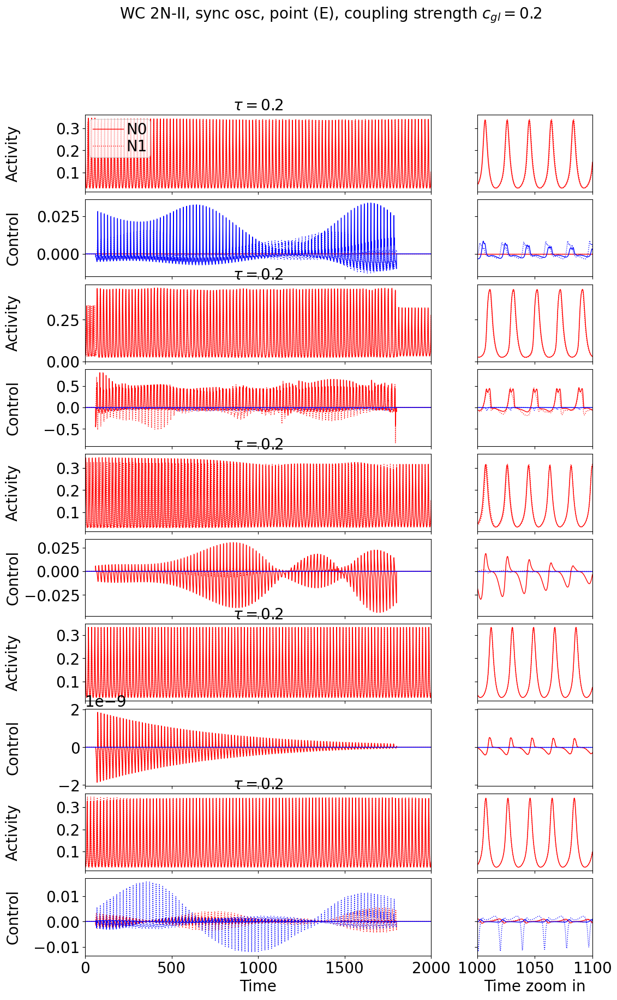

coupling  1


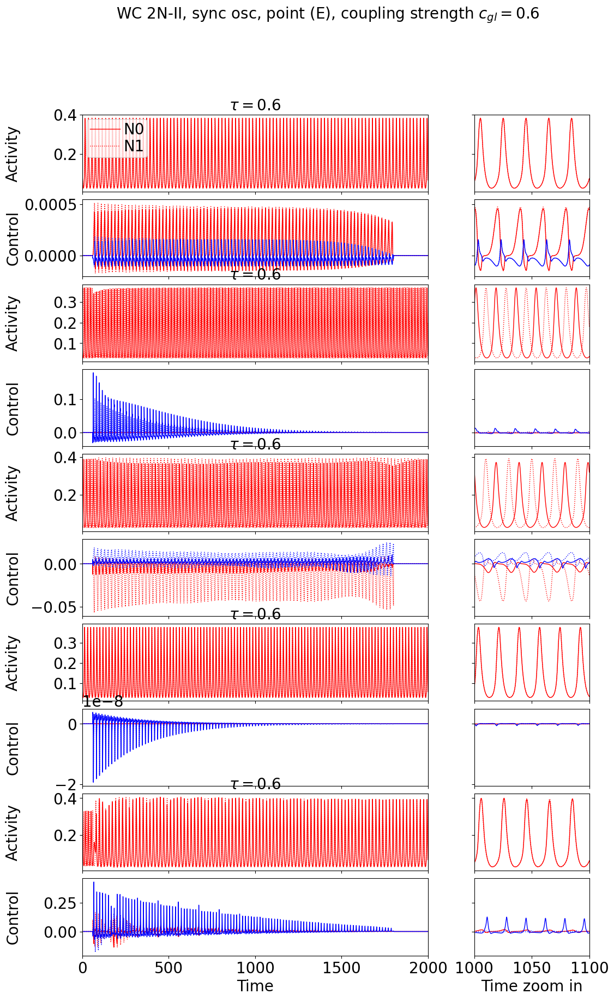

coupling  2


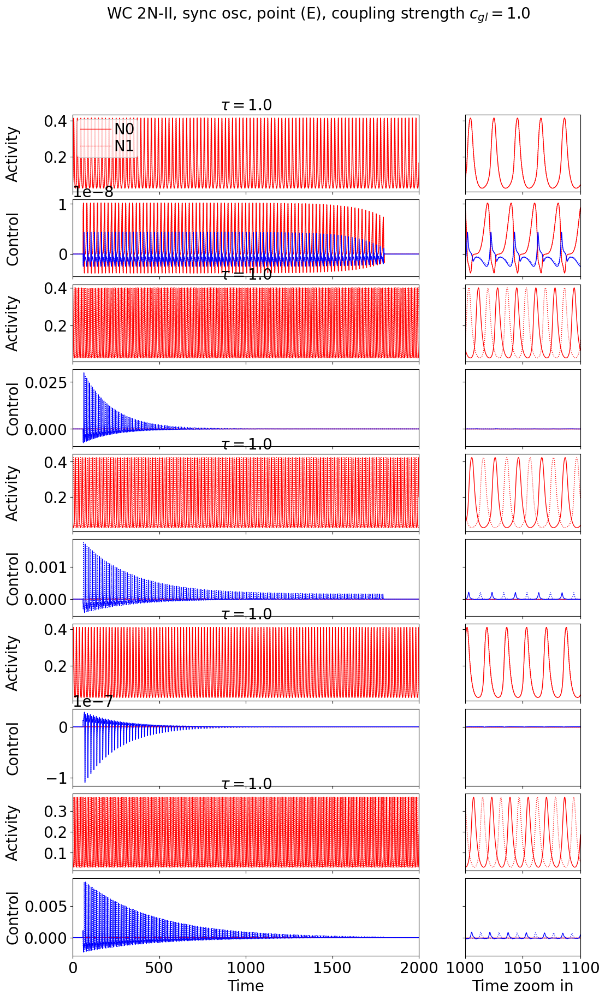

coupling  3


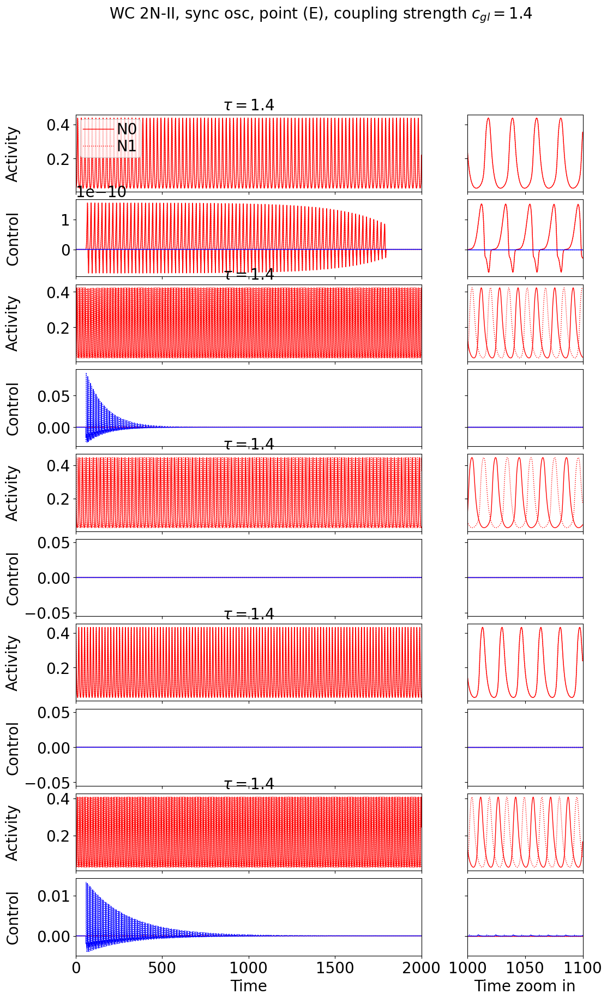

coupling  4


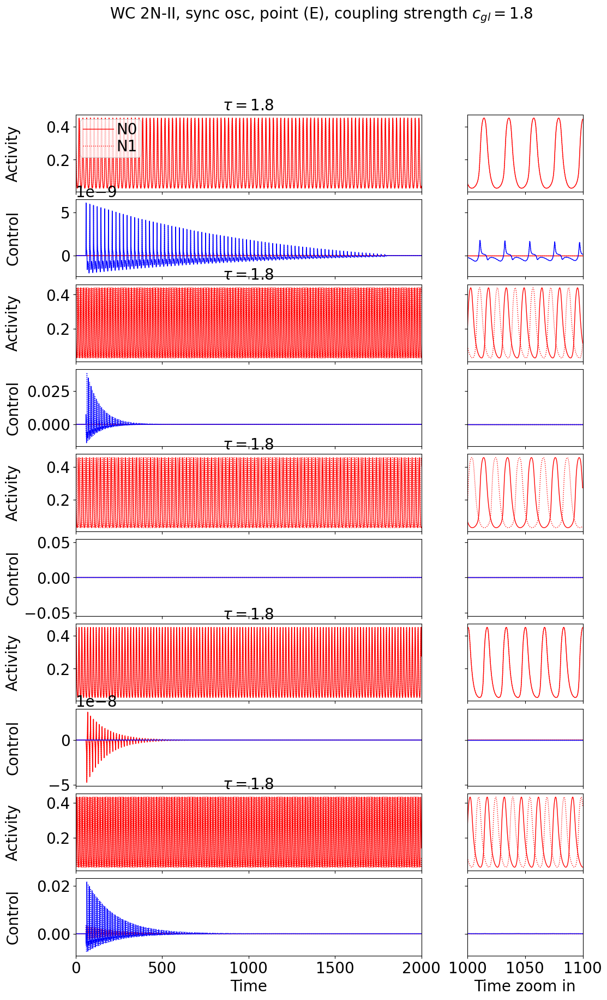

coupling  5


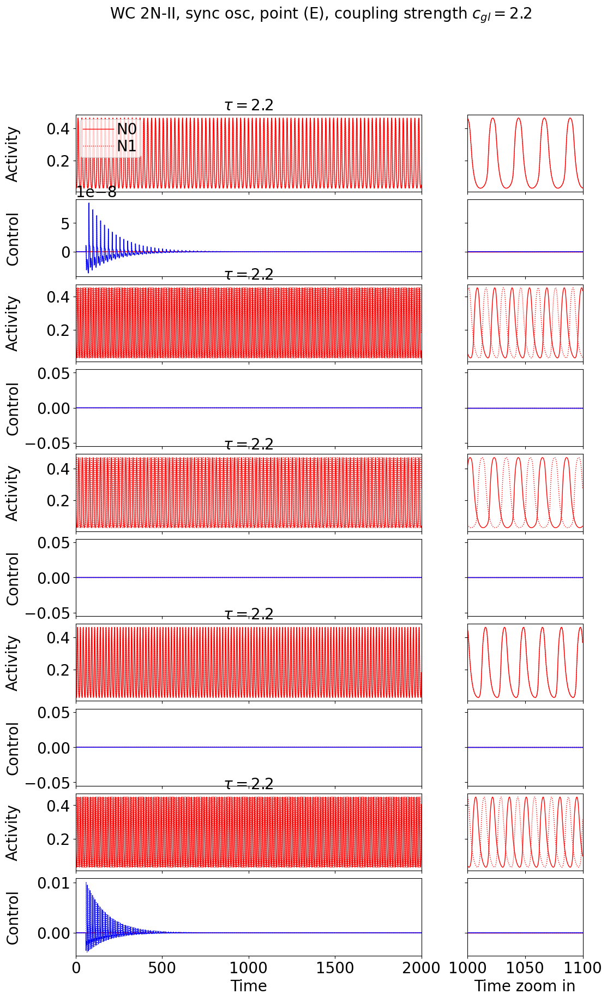

delay  0


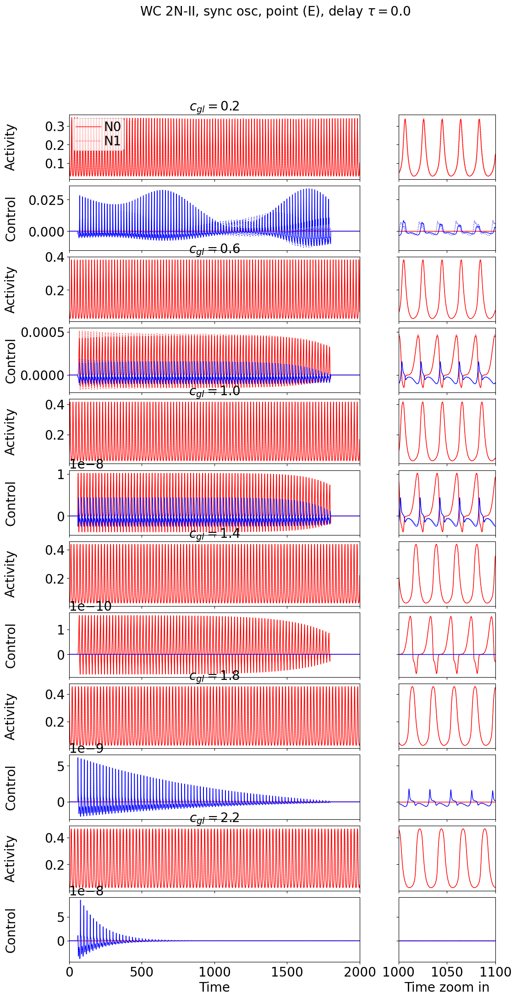

delay  1


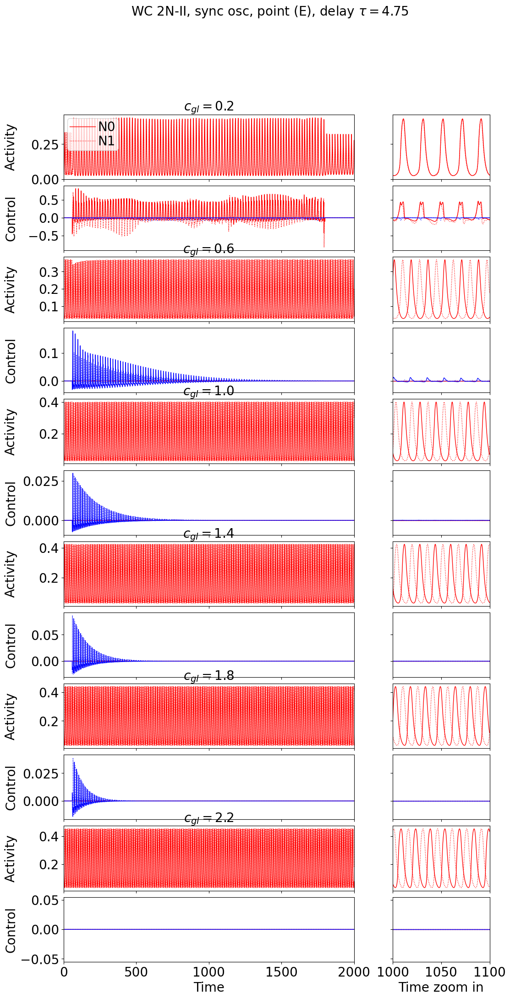

delay  2


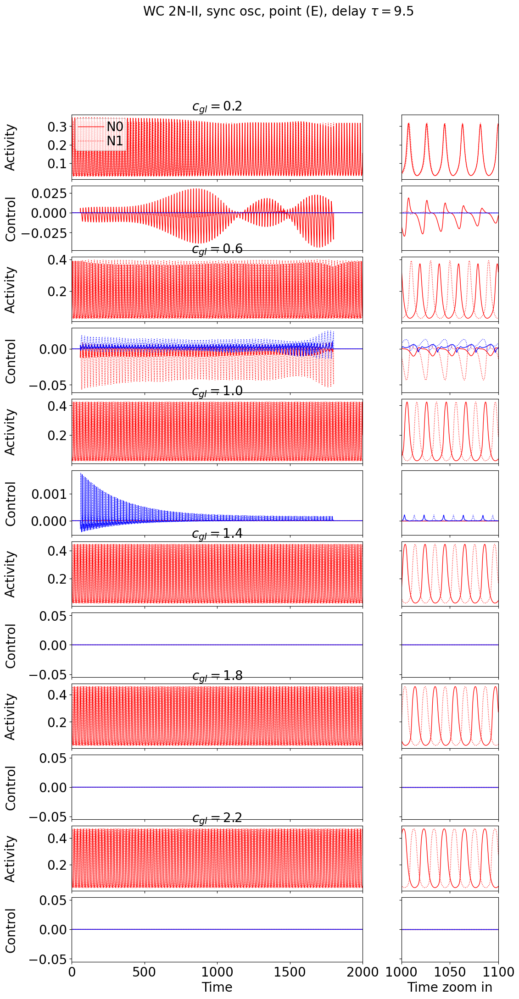

delay  3


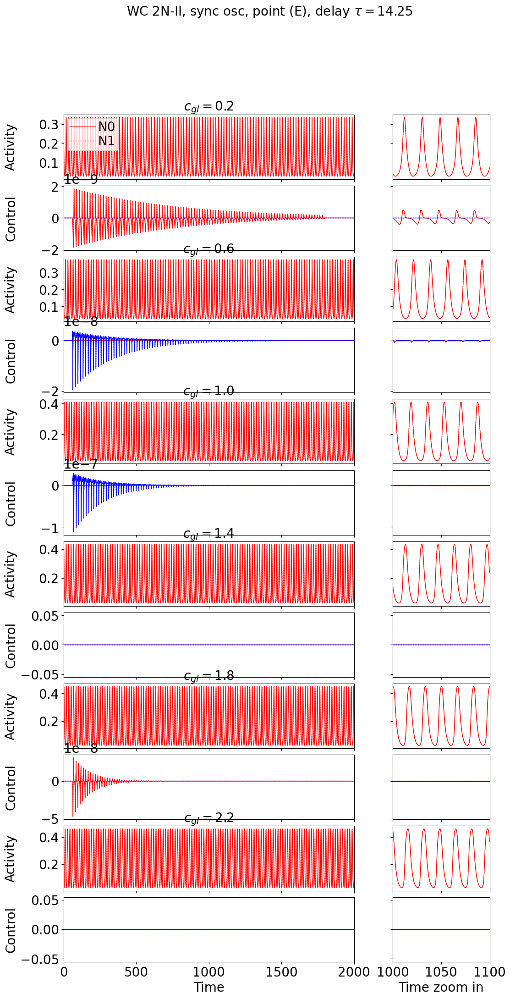

delay  4


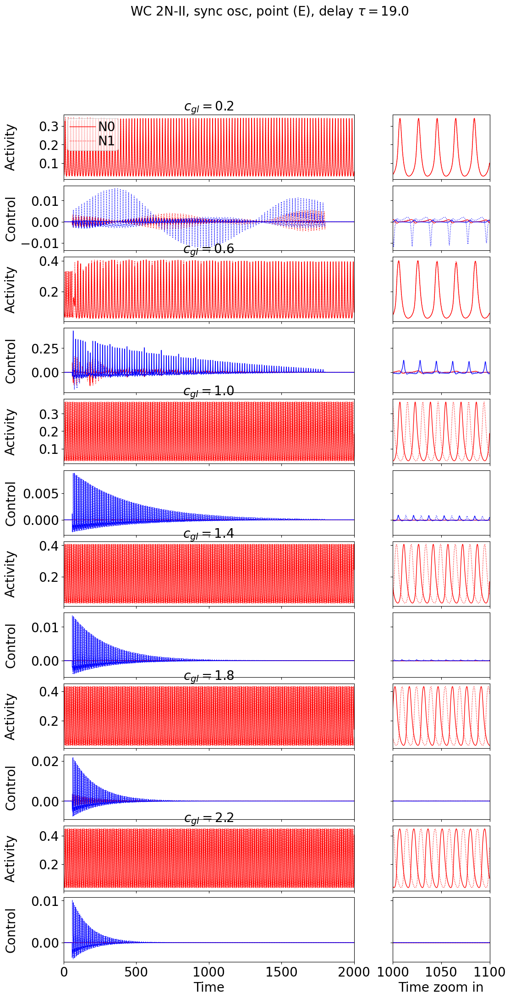

F
coupling  0


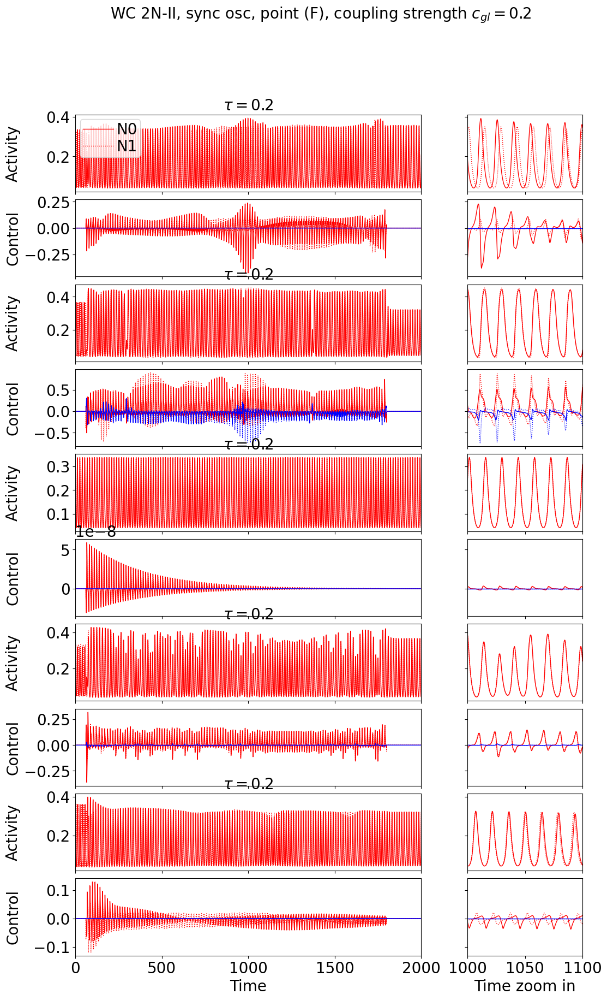

coupling  1


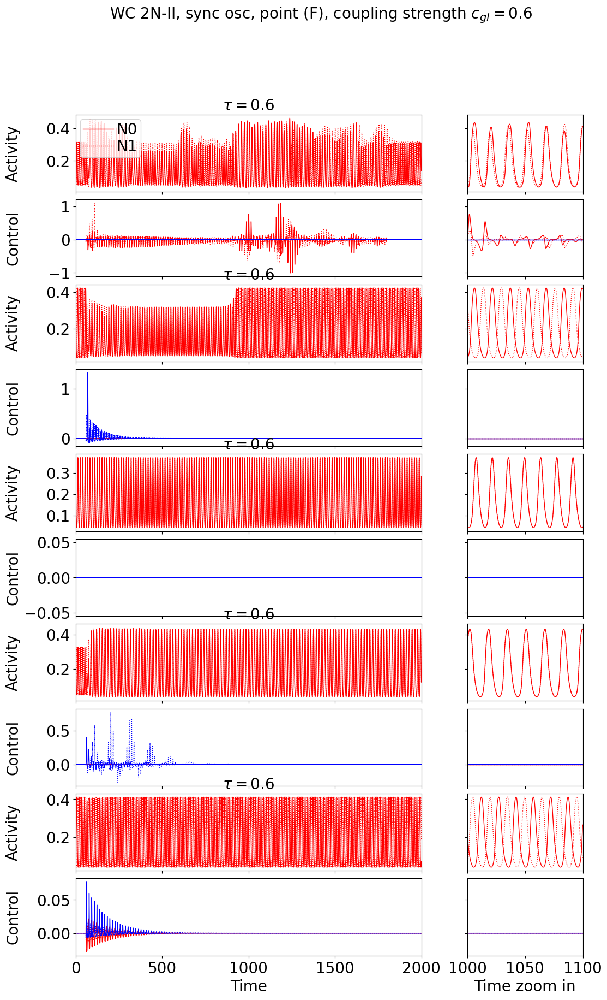

coupling  2


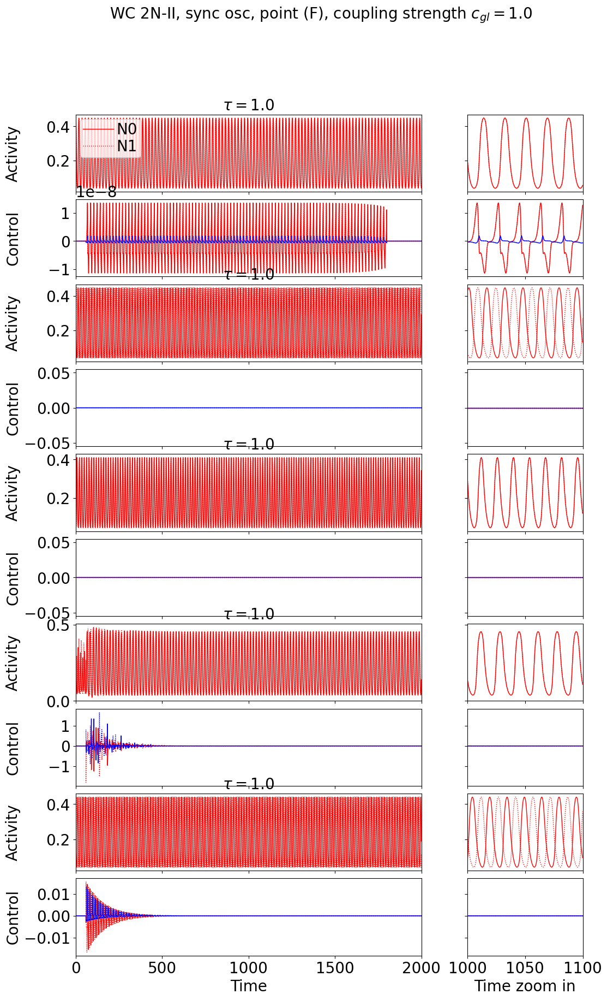

coupling  3


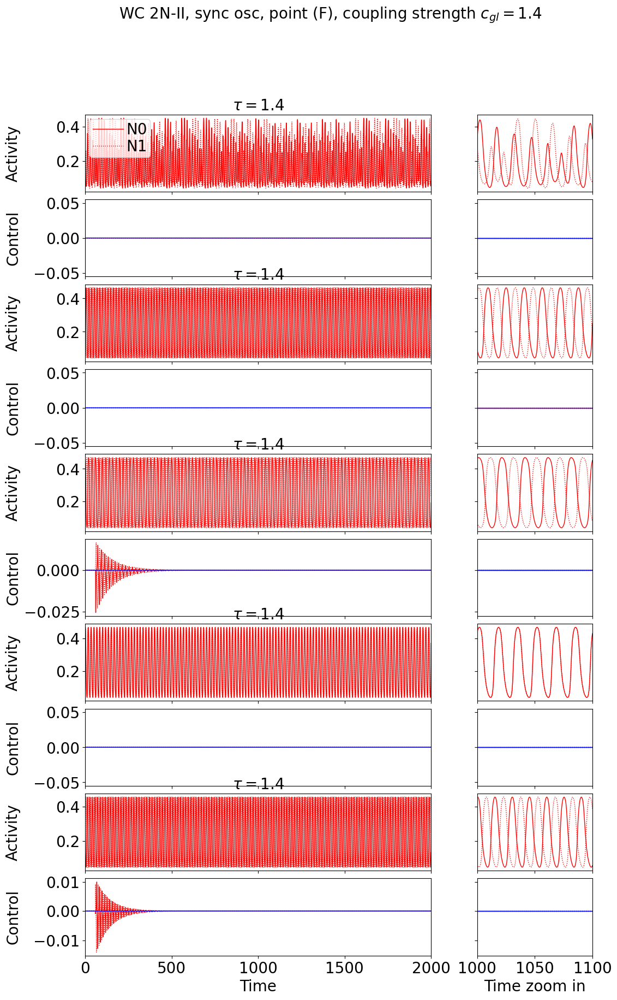

coupling  4


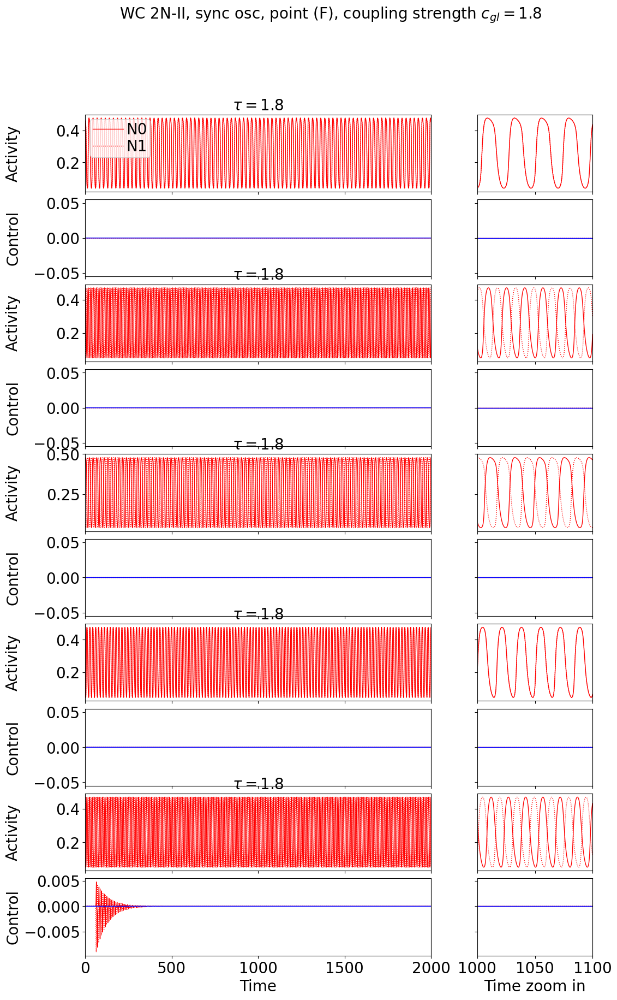

coupling  5


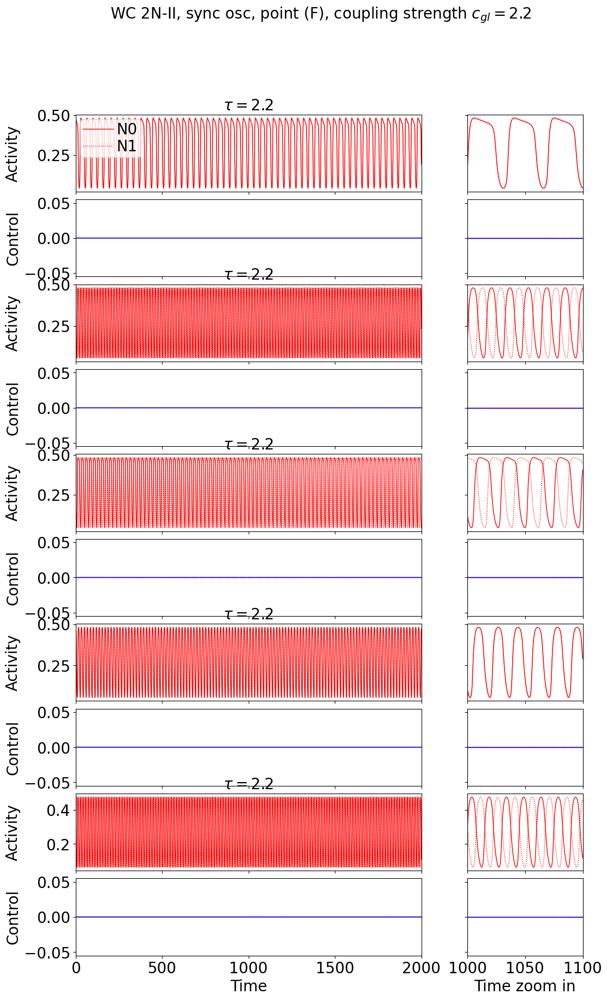

delay  0


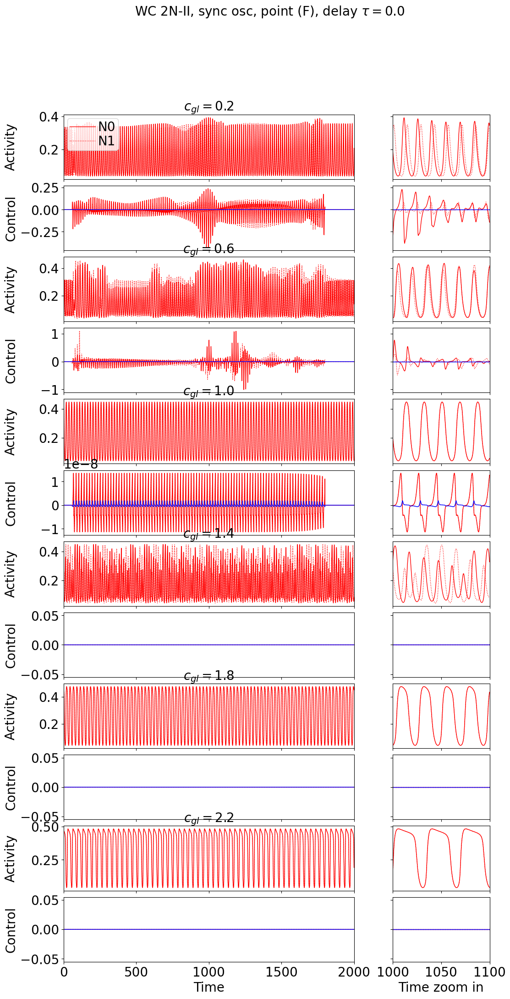

delay  1


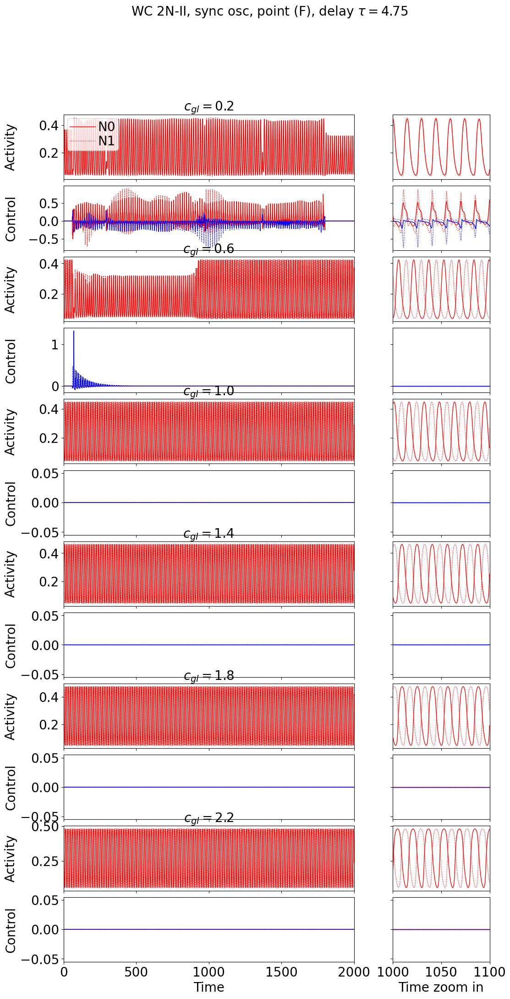

delay  2


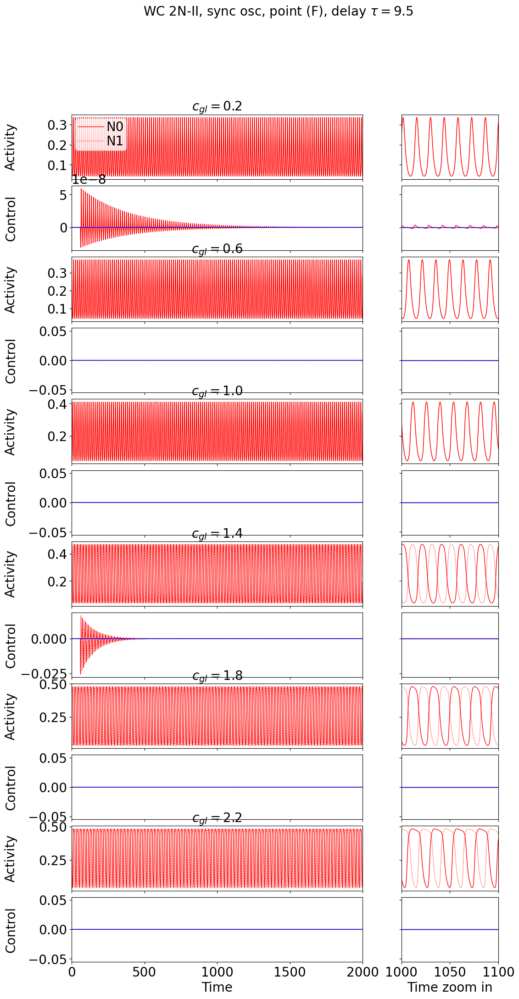

delay  3


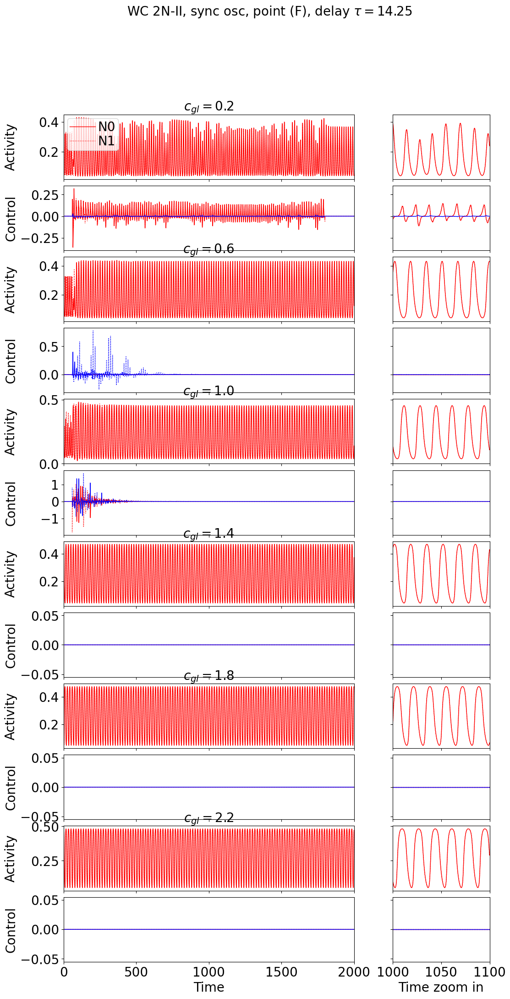

delay  4


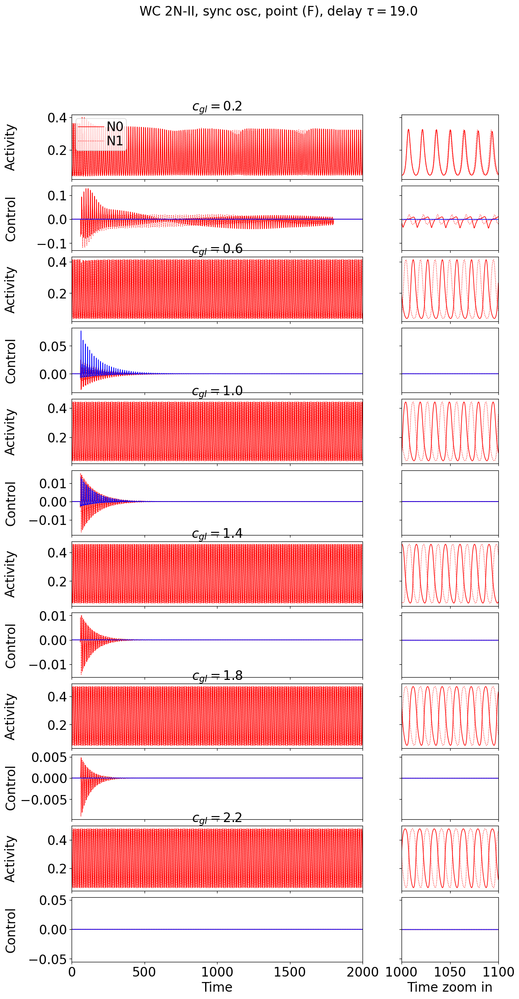

In [217]:
for pi in range(len(p_names)):

    if pi not in [4,5]: continue

    if pi in [0,1,2,3]:
        duration = 100.
    else:
        duration = 2000.

    print(p_names[pi])

    title = "WC 2N-II, "
    if pi in [0,1]: title = title + r"down $\rightarrow$ osc"
    elif pi in [2,3]: title = title + r"up $\rightarrow$ osc"
    elif pi in [4,5]: title = title + r"sync osc"
    title = title + ", point (" + str(p_names[pi]) + ")"

    for ci in range(len(coupling_array)):    
        print("coupling ", ci)
        filename = os.path.join(dir, "2N-II_" + p_names[pi] + "_coupling_" + str(ci) + ".png")
        if pi in [0,1,2,3]:
            plot_delay(data[p_names[pi]], duration, dt, ci, 1, filename, title, zoom=False)
        elif pi in [4,5]:
            plot_delay_nodes(data[p_names[pi]], duration, dt, ci, 1, filename, title)

    for di in range(len(delay_array)):
  
        print("delay ", di)
        filename = os.path.join(dir, "2N-II_" + p_names[pi] + "_delay_" + str(di) + ".png")
        if pi in [0,1,2,3]:
            plot_coupling(data[p_names[pi]], duration, dt, di, 1, filename, title, zoom=False)
        elif pi in [4,5]:
            plot_coupling_nodes(data[p_names[pi]], duration, dt, di, 1, filename, title)

PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0


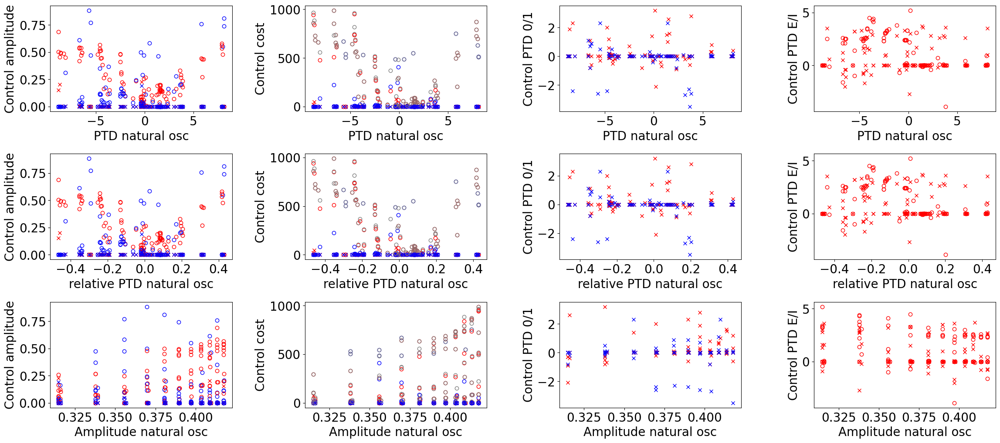

In [36]:
nrows = 3
ncols = 4
i = 0

fig, ax = plt.subplots(nrows, ncols, figsize=(28,12), sharey="col", sharex="row")

for d in [data["E"]]:#, data["F"]]:

    for di in range(len(delay_array)):
        for ci in range(len(coupling_array)):

            if np.abs(d["peak_time_delay"][i][di][ci]) < 0.1:
                print("PTD small ", d["peak_time_delay"][i][di][ci])
                continue

            if np.amax(np.abs(d["control"][i][di][ci])) < 1e-6:
                print("Control amp small (no solution) ", np.amax(np.abs(d["control"][i][di][ci])), di, ci)
                continue

            amp0e = np.amax(np.abs(d["control"][0][di][ci][0,0,1600:-3000])) - np.amin(np.abs(d["control"][0][di][ci][0,0,1600:-3000]))
            amp1e = np.amax(np.abs(d["control"][0][di][ci][1,0,1600:-3000])) - np.amin(np.abs(d["control"][0][di][ci][1,0,1600:-3000]))
            amp0i = np.amax(np.abs(d["control"][0][di][ci][0,1,1600:-3000])) - np.amin(np.abs(d["control"][0][di][ci][0,1,1600:-3000]))
            amp1i = np.amax(np.abs(d["control"][0][di][ci][1,1,1600:-3000])) - np.amin(np.abs(d["control"][0][di][ci][1,1,1600:-3000]))

            total_cost = cost_functions.L2_cost(d["control"][0][di][ci])
            cost0e = np.sum(total_cost[0,0,:])
            cost1e = np.sum(total_cost[1,0,:])
            cost0i = np.sum(total_cost[0,1,:])
            cost1i = np.sum(total_cost[1,1,:])

            td_e01 = get_peak_time_delay(d["control"][0][di][ci][0,0,1600:-3000], d["control"][0][di][ci][1,0,1600:-3000], dt)
            td_i01 = get_peak_time_delay(d["control"][0][di][ci][0,1,1600:-3000], d["control"][0][di][ci][1,1,1600:-3000], dt)
            td_0ei = get_peak_time_delay(d["control"][0][di][ci][0,0,1600:-3000], d["control"][0][di][ci][0,1,1600:-3000], dt)
            td_1ei = get_peak_time_delay(d["control"][0][di][ci][1,0,1600:-3000], d["control"][0][di][ci][1,1,1600:-3000], dt)

            if td_e01 >= 10000: td_e01 = 0
            if td_i01 >= 10000: td_i01 = 0
            if td_0ei >= 10000: td_0ei = 0
            if td_1ei >= 10000: td_1ei = 0

            if amp1e > 2:
                print(di, ci)

            ax[0,0].plot(d["peak_time_delay"][0][di][ci], amp0e, color="red", marker="x")
            ax[0,0].plot(d["peak_time_delay"][0][di][ci], amp1e, color="red", marker="o", fillstyle="none")
            ax[0,0].plot(d["peak_time_delay"][0][di][ci], amp0i, color="blue", marker="x")
            ax[0,0].plot(d["peak_time_delay"][0][di][ci], amp1i, color="blue", marker="o", fillstyle="none")

            ax[1,0].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], amp0e, color="red", marker="x")
            ax[1,0].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], amp1e, color="red", marker="o", fillstyle="none")
            ax[1,0].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], amp0i, color="blue", marker="x")
            ax[1,0].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], amp1i, color="blue", marker="o", fillstyle="none")

            ax[2,0].plot(np.amax(d["amps"][0][di][ci]), amp0e, color="red", marker="x")
            ax[2,0].plot(np.amax(d["amps"][0][di][ci]), amp1e, color="red", marker="o", fillstyle="none")
            ax[2,0].plot(np.amax(d["amps"][0][di][ci]), amp0i, color="blue", marker="x")
            ax[2,0].plot(np.amax(d["amps"][0][di][ci]), amp1i, color="blue", marker="o", fillstyle="none")

            ax[0,1].plot(d["peak_time_delay"][0][di][ci], cost0e, color="red", marker="x")
            ax[0,1].plot(d["peak_time_delay"][0][di][ci], cost1e, color="red", marker="o", fillstyle="none")
            ax[0,1].plot(d["peak_time_delay"][0][di][ci], cost0i, color="blue", marker="x")
            ax[0,1].plot(d["peak_time_delay"][0][di][ci], cost1i, color="blue", marker="o", fillstyle="none")
            ax[0,1].plot(d["peak_time_delay"][0][di][ci], cost0e + cost1e + cost0i + cost1i, color="gray", marker="o", fillstyle="none")

            ax[1,1].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], cost0e, color="red", marker="x")
            ax[1,1].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], cost1e, color="red", marker="o", fillstyle="none")
            ax[1,1].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], cost0i, color="blue", marker="x")
            ax[1,1].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], cost1i, color="blue", marker="o", fillstyle="none")
            ax[1,1].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], cost0e + cost1e + cost0i + cost1i, color="gray", marker="o", fillstyle="none")

            ax[2,1].plot(np.amax(d["amps"][0][di][ci]), cost0e, color="red", marker="x")
            ax[2,1].plot(np.amax(d["amps"][0][di][ci]), cost1e, color="red", marker="o", fillstyle="none")
            ax[2,1].plot(np.amax(d["amps"][0][di][ci]), cost0i, color="blue", marker="x")
            ax[2,1].plot(np.amax(d["amps"][0][di][ci]), cost1i, color="blue", marker="o", fillstyle="none")
            ax[2,1].plot(np.amax(d["amps"][0][di][ci]), cost0e + cost1e + cost0i + cost1i, color="gray", marker="o", fillstyle="none")

            ax[0,2].plot(d["peak_time_delay"][0][di][ci], td_e01, color="red", marker="x")
            ax[0,2].plot(d["peak_time_delay"][0][di][ci], td_i01, color="blue", marker="x")

            ax[1,2].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], td_e01, color="red", marker="x")
            ax[1,2].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], td_i01, color="blue", marker="x")

            ax[2,2].plot(np.amax(d["amps"][0][di][ci]), td_e01, color="red", marker="x")
            ax[2,2].plot(np.amax(d["amps"][0][di][ci]), td_i01, color="blue", marker="x")

            ax[0,3].plot(d["peak_time_delay"][0][di][ci], td_0ei, color="red", marker="x")
            ax[0,3].plot(d["peak_time_delay"][0][di][ci], td_1ei, color="red", marker="o", fillstyle="none")

            ax[1,3].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], td_0ei, color="red", marker="x")
            ax[1,3].plot(d["peak_time_delay"][0][di][ci]/d["natural_period"][0][di][ci], td_1ei, color="red", marker="o", fillstyle="none")

            ax[2,3].plot(np.amax(d["amps"][0][di][ci]), td_0ei, color="red", marker="x")
            ax[2,3].plot(np.amax(d["amps"][0][di][ci]), td_1ei, color="red", marker="o", fillstyle="none")

    break


for nr in range(nrows):
    ax[nr,0].set_ylabel("Control amplitude")
    ax[nr,1].set_ylabel("Control cost")
    ax[nr,2].set_ylabel("Control PTD 0/1")
    ax[nr,3].set_ylabel("Control PTD E/I")

for nc in range(ncols):
    ax[0,nc].set_xlabel("PTD natural osc")
    ax[1,nc].set_xlabel("relative PTD natural osc")
    ax[2,nc].set_xlabel("Amplitude natural osc")

plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.show()

PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
Control amp small (no solution)  0.0
PTD small  0.0
PTD small  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
Control amp small (no solution)  0.0
Control amp small (no solution)  0.0
PTD small  0.0
PTD small  0.0
PTD small  0.0
Control amp small (no solution)  0.0


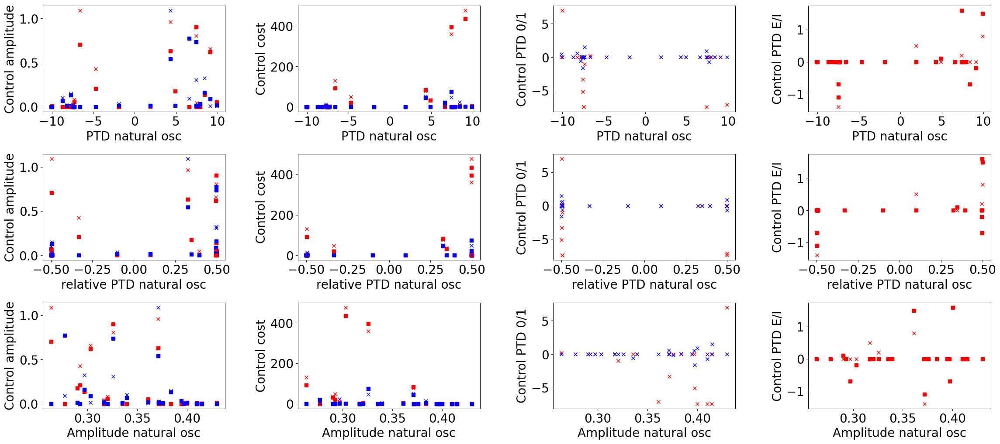

In [247]:
nrows = 3
ncols = 4
i = 1

fig, ax = plt.subplots(nrows, ncols, figsize=(28,12), sharey="col", sharex="row")

for d in [data["E"], data["F"]]:

    print("--------------------------------------")

    for di in range(len(delay_array)):
        for ci in range(len(coupling_array)):

            if np.abs(d["peak_time_delay"][i][di][ci]) < 0.1:
                print("PTD small ", d["peak_time_delay"][i][di][ci])
                continue

            if np.amax(np.abs(d["control"][i][di][ci])) < 1e-6:
                print("Control amp small (no solution) ", np.amax(np.abs(d["control"][i][di][ci])), di, ci)
                continue

            amp0e = np.amax(np.abs(d["control"][i][di][ci][0,0,1600:-3000])) - np.amin(np.abs(d["control"][i][di][ci][0,0,1600:-3000]))
            amp1e = np.amax(np.abs(d["control"][i][di][ci][1,0,1600:-3000])) - np.amin(np.abs(d["control"][i][di][ci][1,0,1600:-3000]))
            amp0i = np.amax(np.abs(d["control"][i][di][ci][0,1,1600:-3000])) - np.amin(np.abs(d["control"][i][di][ci][0,1,1600:-3000]))
            amp1i = np.amax(np.abs(d["control"][i][di][ci][1,1,1600:-3000])) - np.amin(np.abs(d["control"][i][di][ci][1,1,1600:-3000]))

            total_cost = cost_functions.L2_cost(d["control"][i][di][ci])
            cost0e = np.sum(total_cost[0,0,:])
            cost1e = np.sum(total_cost[1,0,:])
            cost0i = np.sum(total_cost[0,1,:])
            cost1i = np.sum(total_cost[1,1,:])

            td_e01 = get_peak_time_delay(d["control"][i][di][ci][0,0,1600:-3000], d["control"][i][di][ci][1,0,1600:-3000], dt)
            td_i01 = get_peak_time_delay(d["control"][i][di][ci][0,1,1600:-3000], d["control"][i][di][ci][1,1,1600:-3000], dt)
            td_0ei = get_peak_time_delay(d["control"][i][di][ci][0,0,1600:-3000], d["control"][i][di][ci][0,1,1600:-3000], dt)
            td_1ei = get_peak_time_delay(d["control"][i][di][ci][1,0,1600:-3000], d["control"][i][di][ci][1,1,1600:-3000], dt)

            if td_e01 >= 10000: td_e01 = 0
            if td_i01 >= 10000: td_i01 = 0
            if td_0ei >= 10000: td_0ei = 0
            if td_1ei >= 10000: td_1ei = 0

            ax[0,0].plot(d["peak_time_delay"][i][di][ci], amp0e, color="red", marker="x")
            ax[0,0].plot(d["peak_time_delay"][i][di][ci], amp1e, color="red", marker="o", facecolor="none")
            ax[0,0].plot(d["peak_time_delay"][i][di][ci], amp0i, color="blue", marker="x")
            ax[0,0].plot(d["peak_time_delay"][i][di][ci], amp1i, color="blue", marker="o", facecolor="none")

            ax[1,0].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], amp0e, color="red", marker="x")
            ax[1,0].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], amp1e, color="red", marker="o", facecolor="none")
            ax[1,0].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], amp0i, color="blue", marker="x")
            ax[1,0].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], amp1i, color="blue", marker="o", facecolor="none")

            ax[2,0].plot(np.amax(d["amps"][i][di][ci]), amp0e, color="red", marker="x")
            ax[2,0].plot(np.amax(d["amps"][i][di][ci]), amp1e, color="red", marker="o", facecolor="none")
            ax[2,0].plot(np.amax(d["amps"][i][di][ci]), amp0i, color="blue", marker="x")
            ax[2,0].plot(np.amax(d["amps"][i][di][ci]), amp1i, color="blue", marker="o", facecolor="none")

            ax[0,1].plot(d["peak_time_delay"][i][di][ci], cost0e, color="red", marker="x")
            ax[0,1].plot(d["peak_time_delay"][i][di][ci], cost1e, color="red", marker="o", facecolor="none")
            ax[0,1].plot(d["peak_time_delay"][i][di][ci], cost0i, color="blue", marker="x")
            ax[0,1].plot(d["peak_time_delay"][i][di][ci], cost1i, color="blue", marker="o", facecolor="none")

            ax[1,1].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], cost0e, color="red", marker="x")
            ax[1,1].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], cost1e, color="red", marker="o", facecolor="none")
            ax[1,1].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], cost0i, color="blue", marker="x")
            ax[1,1].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], cost1i, color="blue", marker="o", facecolor="none")

            ax[2,1].plot(np.amax(d["amps"][i][di][ci]), cost0e, color="red", marker="x")
            ax[2,1].plot(np.amax(d["amps"][i][di][ci]), cost1e, color="red", marker="o", facecolor="none")
            ax[2,1].plot(np.amax(d["amps"][i][di][ci]), cost0i, color="blue", marker="x")
            ax[2,1].plot(np.amax(d["amps"][i][di][ci]), cost1i, color="blue", marker="o", facecolor="none")

            ax[0,2].plot(d["peak_time_delay"][i][di][ci], td_e01, color="red", marker="x")
            ax[0,2].plot(d["peak_time_delay"][i][di][ci], td_i01, color="blue", marker="x")

            ax[1,2].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], td_e01, color="red", marker="x")
            ax[1,2].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], td_i01, color="blue", marker="x")

            ax[2,2].plot(np.amax(d["amps"][i][di][ci]), td_e01, color="red", marker="x")
            ax[2,2].plot(np.amax(d["amps"][i][di][ci]), td_i01, color="blue", marker="x")

            ax[0,3].plot(d["peak_time_delay"][i][di][ci], td_0ei, color="red", marker="x")
            ax[0,3].plot(d["peak_time_delay"][i][di][ci], td_1ei, color="red", marker="o", facecolor="none")

            ax[1,3].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], td_0ei, color="red", marker="x")
            ax[1,3].plot(d["peak_time_delay"][i][di][ci]/d["natural_period"][i][di][ci], td_1ei, color="red", marker="o", facecolor="none")

            ax[2,3].plot(np.amax(d["amps"][i][di][ci]), td_0ei, color="red", marker="x")
            ax[2,3].plot(np.amax(d["amps"][i][di][ci]), td_1ei, color="red", marker="o", facecolor="none")


for nr in range(nrows):
    ax[nr,0].set_ylabel("Control amplitude")
    ax[nr,1].set_ylabel("Control cost")
    ax[nr,2].set_ylabel("Control PTD 0/1")
    ax[nr,3].set_ylabel("Control PTD E/I")

for nc in range(ncols):
    ax[0,nc].set_xlabel("PTD natural osc")
    ax[1,nc].set_xlabel("relative PTD natural osc")
    ax[2,nc].set_xlabel("Amplitude natural osc")

plt.subplots_adjust(wspace=0.4, hspace=0.4)
plt.show()